In [1]:
from astropy.io import fits
import matplotlib.pyplot as plt
import os
from glob import glob
from astropy.visualization import ZScaleInterval
from astropy.visualization import ImageNormalize
from astropy.wcs import WCS
from astropy.nddata import Cutout2D
from astropy.coordinates import SkyCoord
import astropy.units as u
import numpy as np
import matplotlib.gridspec as gridspec
from astropy.table import Table
from scipy import interpolate
import scipy.ndimage as ndimage
from photutils.aperture import SkyEllipticalAperture
from photutils.aperture import aperture_photometry
from astropy.visualization import simple_norm
import pandas as pd
from astropy.stats import SigmaClip
from astropy.stats import sigma_clipped_stats

In [2]:
#plot setting
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'
plt.rcParams['mathtext.fontset']='stix'
plt.rcParams['lines.linewidth'] = 1
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 15
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'
plt.rcParams['xtick.minor.visible'] = True
plt.rcParams['ytick.minor.visible'] = True
plt.rcParams['xtick.major.size'] = 6
plt.rcParams['ytick.major.size'] = 6
plt.rcParams['xtick.minor.size'] = 4
plt.rcParams['ytick.minor.size'] = 4
plt.rcParams['xtick.major.width'] = 1
plt.rcParams['ytick.major.width'] = 1
plt.rcParams['xtick.minor.width'] = 1
plt.rcParams['ytick.minor.width'] = 1
plt.rcParams['axes.spines.bottom']=True
plt.rcParams['axes.spines.left']=True
plt.rcParams['axes.spines.top']=True
plt.rcParams['axes.spines.right']=True
plt.rcParams['xtick.bottom']=True
plt.rcParams['xtick.labelbottom']=True
plt.rcParams['ytick.left']=True
plt.rcParams['ytick.labelleft']=True
plt.rcParams['xtick.color'] = 'white'
plt.rcParams['ytick.color'] = 'white'
plt.rcParams['xtick.labelcolor'] = 'black'
plt.rcParams['ytick.labelcolor'] = 'black'

In [3]:
hdu = fits.open('E:/THU/OII_emitter/data/COSMOS-archive/results/candels_cutouts/0001_150.15979000_2.19117000_hlsp_candels_hst_acs_cos-tot_f606w_v1.0_drz.fits')

In [5]:
path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/kpno_sci/'
with fits.open(glob(path+'*Ks*fits')[0]) as hdu:
    hdu.info()


Filename: E:/THU/OII_emitter/data/COSMOS-archive/results/kpno_sci\0001_150.15979000_2.19117000_kpno_Ks_matched-psf_065_sci_30.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      97   (201, 201)   float32   


In [4]:
hdu.info()

Filename: E:/THU/OII_emitter/data/COSMOS-archive/results/candels_cutouts/0001_150.15979000_2.19117000_hlsp_candels_hst_acs_cos-tot_f606w_v1.0_drz.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     165   (1001, 1001)   float32   


In [29]:
hdu[0].header

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                   16 / number of bits per data pixel                  
NAXIS   =                    0 / number of data axes                            
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 

In [30]:
hdu.close()

In [9]:
hdu[0].header

SIMPLE  =                    T / conforms to FITS standard                      
BITPIX  =                    8 / array data type                                
NAXIS   =                    0 / number of array dimensions                     
EXTEND  =                    T                                                  

In [10]:
hdu.close()

In [11]:
hdu = fits.open('E:/THU/data/cutout-HSC-I-9813-pdr1_ssp_uh_cosmos-230724-073320.fits')
hdu.info()

Filename: E:/THU/data/cutout-HSC-I-9813-pdr1_ssp_uh_cosmos-230724-073320.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      22   ()      
  1  IMAGE         1 ImageHDU        34   (121, 120)   float32   
  2                1 ImageHDU         5   ()      
  3                1 ImageHDU         5   ()      


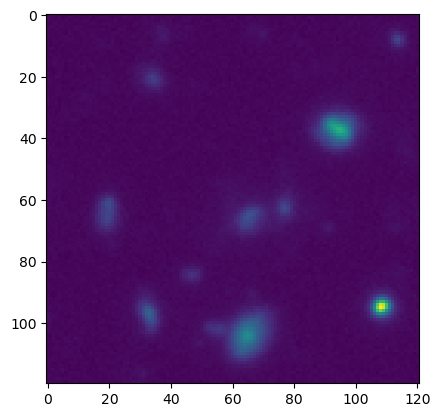

In [13]:
plt.imshow(hdu[1].data)

In [17]:
for f in os.listdir('E:/THU/data/NB718-9813-4-4'):
    #print(f)
    with fits.open('E:/THU/data/NB718-9813-4-4/%s'%f) as hdu:
        hdu.info()

Filename: E:/THU/data/NB718-9813-4-4/calexp-NB0718-9813-4,4.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      18   ()      
  1  COMPRESSED_IMAGE    1 CompImageHDU     34   (4200, 4200)   float32   
  2  COMPRESSED_IMAGE    1 CompImageHDU     51   (4200, 4200)   int32   
  3  COMPRESSED_IMAGE    1 CompImageHDU     34   (4200, 4200)   float32   
  4                1 BinTableHDU     40   8463R x 7C   [1J, 1J, 1J, 1J, 1J, 64A, 64A]   
  5                1 BinTableHDU     76   23R x 15C   [1J, 1J, 1J, 1J, 1J, 1J, 1J, 1K, 1J, 1J, 1J, 1J, 1J, 1D, 32A]   
  6                1 BinTableHDU     16   151R x 1C   [1QB(28848)]   
  7                1 BinTableHDU     22   149R x 2C   [1D, 1D]   
  8                1 BinTableHDU    103   126R x 19C   [1K, 1D, 1D, 1K, 1D, 1D, 1D, 1D, 1D, 1D, 1D, 1D, 1J, 1D, 1D, 1D, 1D, 1D, 1D]   
  9                1 BinTableHDU     84   126R x 17C   [1J, 1J, 1J, 1J, 1J, 1J, 1J, 1K, 1J, 1J, 1J, 1J, 1J, 1K, 1J, 1D, 

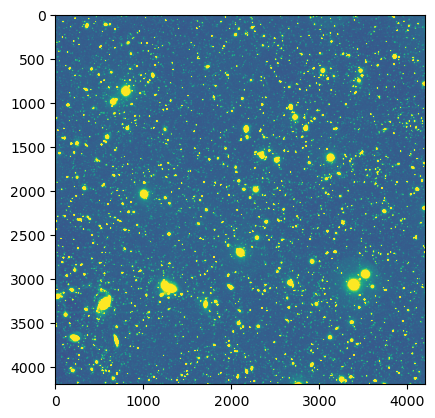

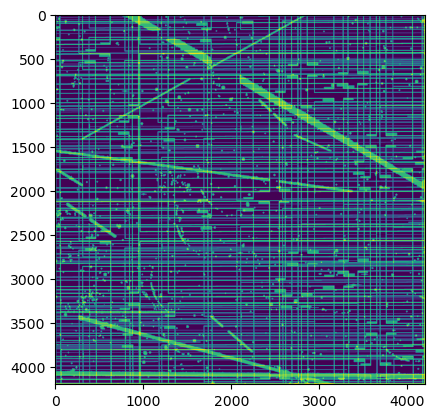

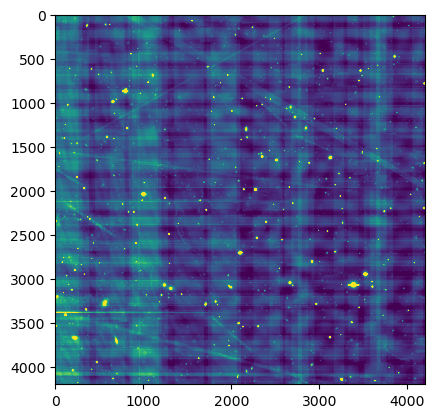

In [23]:
with fits.open('E:/THU/data/NB718-9813-4-4/calexp-NB0718-9813-4,4.fits') as hdu:
    for i in range(1,4):
        norm = ImageNormalize(hdu[i].data, interval=ZScaleInterval())
        plt.imshow(hdu[i].data, norm=norm)
        plt.show()

In [26]:
with fits.open('E:/THU/data/ICSRC-0106898-070.fits') as hdu:
    print(hdu[1].columns)

ColDefs(
    name = 'flags'; format = '206X'
    name = 'id'; format = '1K'
    name = 'coord_ra'; format = '1D'; unit = 'rad'
    name = 'coord_dec'; format = '1D'; unit = 'rad'
    name = 'parent'; format = '1K'
    name = 'base_SdssCentroid_x'; format = '1D'; unit = 'pixel'
    name = 'base_SdssCentroid_y'; format = '1D'; unit = 'pixel'
    name = 'base_SdssCentroid_xSigma'; format = '1E'; unit = 'pixel'
    name = 'base_SdssCentroid_ySigma'; format = '1E'; unit = 'pixel'
    name = 'base_FPPosition_x'; format = '1D'; unit = 'mm'
    name = 'base_FPPosition_y'; format = '1D'; unit = 'mm'
    name = 'base_Jacobian_value'; format = '1D'
    name = 'base_SdssShape_xx'; format = '1D'; unit = 'pixel^2'
    name = 'base_SdssShape_yy'; format = '1D'; unit = 'pixel^2'
    name = 'base_SdssShape_xy'; format = '1D'; unit = 'pixel^2'
    name = 'base_SdssShape_xxSigma'; format = '1E'; unit = 'pixel^2'
    name = 'base_SdssShape_yySigma'; format = '1E'; unit = 'pixel^2'
    name = 'base_SdssSha

## OII intensity map

In [7]:
c = SkyCoord('10:00:38.315 +02:11:28.55', frame='icrs', unit=(u.hourangle, u.deg))
#cutout = Cutout2D(hdu[1].data, position=c, size=5*u.arcsec, wcs=wcs)

In [6]:
hdu = fits.open('E:/THU/OII_emitter/data/SUBARU/HSC-Z-9813-4-4/calexp-HSC-Z-9813-4,4.fits')
wcs = WCS(hdu[1].header)
img = hdu[1].data
img_cutout = Cutout2D(img, position=c, size=10*u.arcsec, wcs=wcs)

In [29]:
wcs

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN'  'DEC--TAN'  
CRVAL : 150.247933884298  2.23140495867768  
CRPIX : 2100.0  2100.0  
CD1_1 CD1_2  : -4.6666666666639e-05  0.0  
CD2_1 CD2_2  : 0.0  4.6666666666639e-05  
NAXIS : 4200  4200

In [30]:
img_cutout.wcs

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN'  'DEC--TAN'  
CRVAL : 150.247933884298  2.23140495867768  
CRPIX : -1860.0  891.0  
CD1_1 CD1_2  : -4.6666666666639e-05  0.0  
CD2_1 CD2_2  : 0.0  4.6666666666639e-05  
NAXIS : 60  60

In [20]:
hdu.info()

Filename: E:/THU/OII_emitter/data/SUBARU/NB0718-9813-4-4/calexp-NB0718-9813-4,4.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      18   ()      
  1  COMPRESSED_IMAGE    1 CompImageHDU     34   (4200, 4200)   float32   
  2  COMPRESSED_IMAGE    1 CompImageHDU     51   (4200, 4200)   int32   
  3  COMPRESSED_IMAGE    1 CompImageHDU     34   (4200, 4200)   float32   
  4                1 BinTableHDU     40   8463R x 7C   ['1J', '1J', '1J', '1J', '1J', '64A', '64A']   
  5                1 BinTableHDU     76   23R x 15C   [1J, 1J, 1J, 1J, 1J, 1J, 1J, 1K, 1J, 1J, 1J, 1J, 1J, 1D, 32A]   
  6                1 BinTableHDU     16   151R x 1C   [1QB(28848)]   
  7                1 BinTableHDU     22   149R x 2C   [1D, 1D]   
  8                1 BinTableHDU    103   126R x 19C   [1K, 1D, 1D, 1K, 1D, 1D, 1D, 1D, 1D, 1D, 1D, 1D, 1J, 1D, 1D, 1D, 1D, 1D, 1D]   
  9                1 BinTableHDU     84   126R x 17C   [1J, 1J, 1J, 1J, 1J, 1J, 1J, 1K

In [26]:
img = fits.PrimaryHDU(data=hdu[1].data, header=hdu[1].header)
fits.HDUList([img]).writeto('E:/THU/OII_emitter/data/SUBARU/HSC-Z-9813-4-4/image-HSC-Z-9813-4,4.fits', overwrite=True)

In [56]:
header_ = hdu[1].header
header_.update(img_cutout.wcs.to_header())
img_cutout_ = fits.PrimaryHDU(data=img_cutout.data, header=header_)
fits.HDUList([img_cutout_]).writeto('E:/THU/OII_emitter/data/SUBARU/HSC-Z-9813-4-4/image-cutout-HSC-Z-9813-4,4.fits', overwrite=True)

In [24]:
for i in range(4, 26):
    tb = Table.read('E:/THU/OII_emitter/data/SUBARU/NB0718-9813-4-4/calexp-NB0718-9813-4,4.fits', i)
    print(tb)

 id  ...                              module                             
---- ... ----------------------------------------------------------------
   2 ... lsst.afw.geom                                                   
   3 ...                                                                 
   4 ...                                                                 
   5 ... lsst.afw.geom                                                   
   6 ...                                                                 
   7 ...                                                                 
   8 ... lsst.afw.geom                                                   
   9 ...                                                                 
  10 ...                                                                 
  11 ... lsst.afw.geom                                                   
 ... ...                                                              ...
8283 ... lsst.meas.algorithms         

                              name                               field
---------------------------------------------------------------- -----
base_GaussianFlux_flux                                              75
base_GaussianFlux_fluxSigma                                         76
base_PsfFlux_flux                                                   77
base_PsfFlux_fluxSigma                                              78
ext_convolved_ConvolvedFlux_0_3_3_flux                              79
ext_convolved_ConvolvedFlux_0_3_3_fluxSigma                         80
ext_convolved_ConvolvedFlux_0_4_5_flux                              81
ext_convolved_ConvolvedFlux_0_4_5_fluxSigma                         82
ext_convolved_ConvolvedFlux_0_6_0_flux                              83
ext_convolved_ConvolvedFlux_0_6_0_fluxSigma                         84
                                                             ...   ...
ext_convolved_ConvolvedFlux_3_kron_fluxSigma                      8275
ext_ph

In [7]:
header0

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                    8 / number of bits per data pixel                  
NAXIS   =                    0 / number of data axes                            
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
HIERARCH variance_scale = 1.25042493225398                                      
BGMEAN  =  0.00621528073265819                                                  
BGVAR   = 2.86234858560387E-05                                                  
AR_HDU  =                    5 / HDU (1-indexed) containing the archive used to 
HIERARCH COADD_INPUTS_ID =   1 / archive ID for coadd inputs catalogs           
HIERARCH AP_CORR_MAP_ID = 8238 / archive ID for aperture correction map         
PSF_ID  =                 82

In [8]:
header1

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                  -32 / data type of original image                    
NAXIS   =                    2 / dimension of original image                    
NAXIS1  =                 4200 / length of original image axis                  
NAXIS2  =                 4200 / length of original image axis                  
PCOUNT  =                    0 / size of special data area                      
GCOUNT  =                    1 / one data group (required keyword)              
XTENSION= 'BINTABLE'           / binary table extension                         
WCSAXES =                    2 / Number of WCS axes                             
CRPIX1  =                2100. / Reference pixel on axis 1                      
CRPIX2  =                2100. / Reference pixel on axis 2                      
CRVAL1  =     150.247933884298 / Value at ref. pixel on axis 1                  
CRVAL2  =     2.231404958677

In [21]:
c = SkyCoord('10:00:38.315 +02:11:28.55', frame='icrs', unit=(u.hourangle, u.deg))
cutout = Cutout2D(hdu[1].data, position=c, size=5*u.arcsec, wcs=wcs)

In [59]:
np.concatenate([(np.array(cutout.bbox_cutout[0])-cutout.position_cutout[0])*header['CD1_1']*3600, (np.array(cutout.bbox_cutout[1])-cutout.position_cutout[1])*header['CD2_2']*3600])

array([ 9.912, -9.912, -9.912,  9.912])

In [12]:
cutout.slices_original, cutout.slices_cutout, cutout.xmin_original

((slice(1178, 1297, None), slice(3927, 4046, None)),
 (slice(0, 119, None), slice(0, 119, None)),
 3927)

In [46]:
cutout.data.shape

(30, 30)

In [31]:
smooth = ndimage.gaussian_filter(cutout.data, sigma=0.7, order=0)

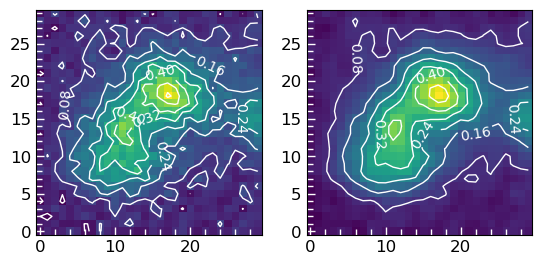

In [32]:
norm1 = ImageNormalize(cutout.data, interval=ZScaleInterval())
plt.subplot(1,2,1)
plt.imshow(cutout.data, norm=norm1, origin='lower')
CS = plt.contour(cutout.data, colors='white')
plt.clabel(CS, CS.levels)
plt.subplot(1,2,2)
norm2 = ImageNormalize(smooth, interval=ZScaleInterval())
plt.imshow(smooth, norm=norm2, origin='lower')
CS2 = plt.contour(smooth, colors='white')
plt.clabel(CS2, CS2.levels)
plt.show()

In [22]:
def plot_1D_curve(band, coords, size, ax_img, ax_x, ax_y, z=0.924, lineflux=True):
    'Band: HSC-G, HSC-I, HSC-R, HSC-Y, HSC-Z, IB0945, NB0387, NB0527, NB0718, NB0816, NB0921, NB0973'
    datapath= 'E:/THU/OII_emitter/data/SUBARU/'
    with fits.open(glob(f'{datapath}/*{band}*/calexp*{band}*.fits')[0]) as hdu:
        data0 = hdu[1].data
        header = hdu[1].header
        wcs = WCS(hdu[1].header)
    
    if lineflux:
        #calculate OII emitting line flux
        OII = 3728 #two mean
        OII_shifted = OII*(1+z)
        trans_file = glob(f'E:/THU/OII_emitter/data/filter/SUBARU/*{band}*')[0]
        trans_curve = np.loadtxt(trans_file)
        f = interpolate.interp1d(trans_curve[:,0], trans_curve[:,1])
        data = data0/f(OII_shifted)
    else:
        data = data0
    
    cutout = Cutout2D(data, position=coords, size=size, wcs=wcs)
    extent = np.concatenate([(np.array(cutout.bbox_cutout[0])-cutout.position_cutout[0])*header['CD1_1']*3600, (np.array(cutout.bbox_cutout[1])-cutout.position_cutout[1])*header['CD2_2']*3600])
    smooth = ndimage.gaussian_filter(cutout.data, sigma=0.7, order=0)
    
    nx, ny = cutout.data.shape
    if nx%2 == 0: array_x = smooth[(nx//2-1):(nx//2+1)].mean(axis=0)
    else: array_x = smooth[nx//2]
    if ny%2 == 0: array_y = smooth[:, (ny//2-1):(ny//2+1)].mean(axis=1)
    else: array_y = smooth[:, ny//2]
    norm_array_x = (array_x - array_x.min()) / (array_x.max() - array_x.min())
    norm_array_y = (array_y - array_y.min()) / (array_y.max() - array_y.min())
    
    #plot #smooth version   
    norm = ImageNormalize(smooth, interval=ZScaleInterval())
    ax_img.imshow(smooth, norm=norm, extent=extent, origin='lower')
    CS = ax_img.contour(smooth, extent=extent, colors='white')
    xmin, xmax = ax_img.get_xlim()
    ymin, ymax = ax_img.get_ylim() 
    ax_img.clabel(CS, CS.levels)
    ax_img.vlines([0], ymin, ymax, colors='white', linestyle='dashed')
    ax_img.hlines([0], xmin, xmax, colors='white', linestyle='dashed')
    ax_img.set_xlabel('$\Delta$ RA[arcsec]')
    ax_img.set_ylabel('$\Delta$ DEC[arcsec]')
    ax_img.text(0.95*xmax, 0.95*ymin, band, color='white', ha='right', va='bottom', fontstyle='italic', fontweight='bold')
 
    ax_x.plot(array_x, 'k-')
    ax_x.set_xticks([])
    ax_y.plot(array_y, np.arange(norm_array_y.shape[0]), 'k-')
    ax_y.set_yticks([])

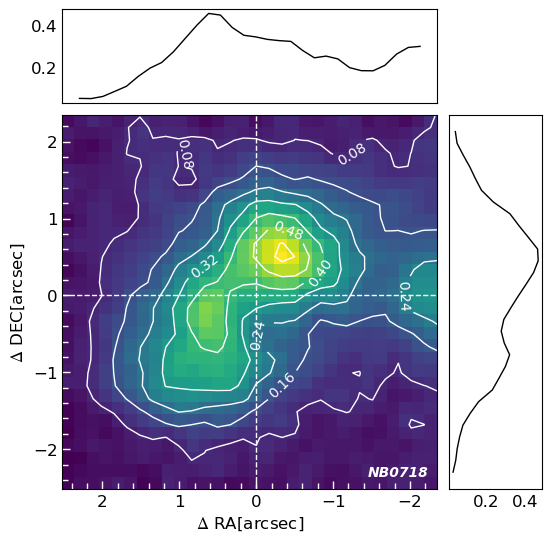

In [23]:
coords = SkyCoord('10:00:38.315 +02:11:28.55', frame='icrs', unit=(u.hourangle, u.deg))
size = 5*u.arcsec
band = 'NB0718'
# Start with a square Figure.
fig = plt.figure(figsize=(6, 6))
# Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
# the size of the marginal axes and the main axes in both directions.
# Also adjust the subplot parameters for a square plot.
gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                      left=0.1, right=0.9, bottom=0.1, top=0.9,
                      wspace=0.05, hspace=0.05)
# Create the Axes.
ax_img = fig.add_subplot(gs[1, 0])
ax_x = fig.add_subplot(gs[0, 0])
ax_y = fig.add_subplot(gs[1, 1])
#plot
plot_1D_curve(band, coords, size, ax_img, ax_x, ax_y)
plt.savefig(f'E:/THU/OII_emitter/intensity_map/intensity_map_{band}_OII_v1.png')
plt.show()

### mutilband intensity map

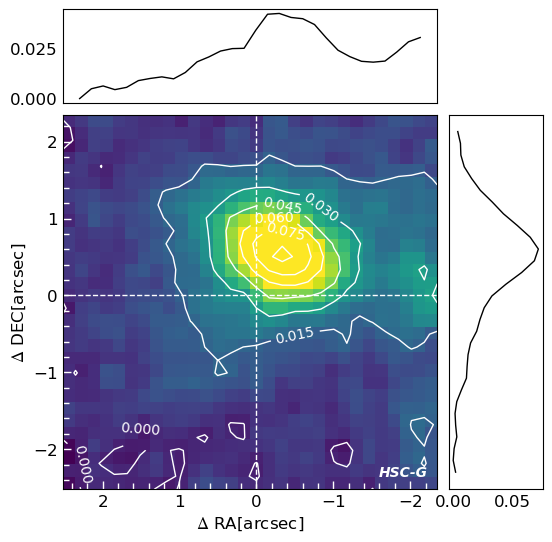

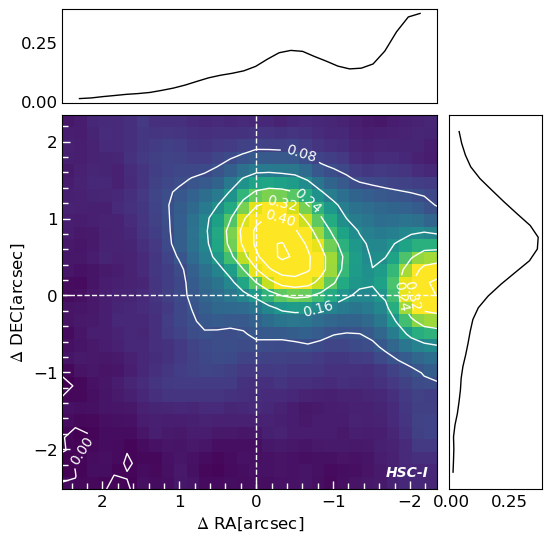

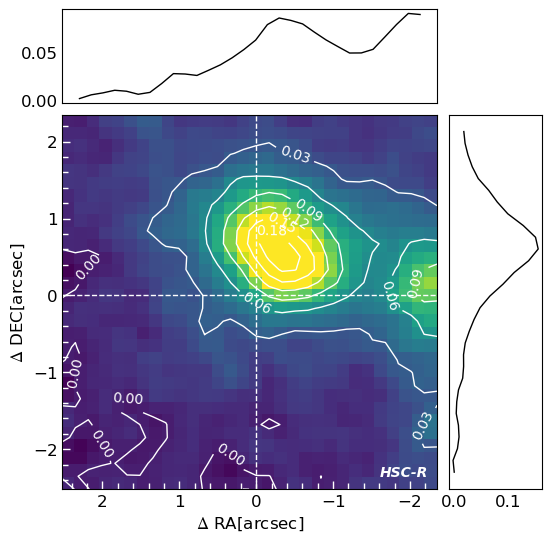

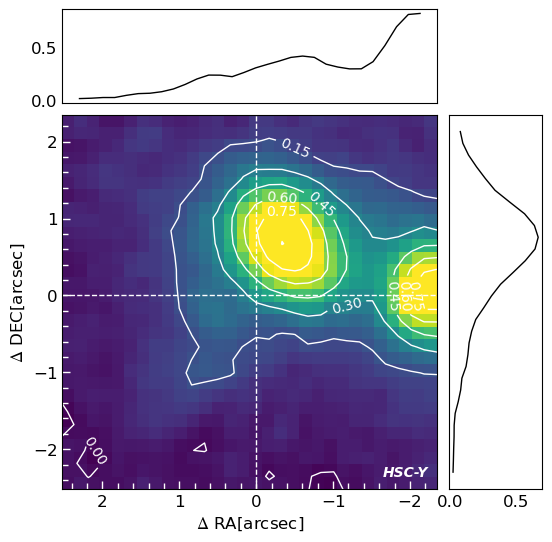

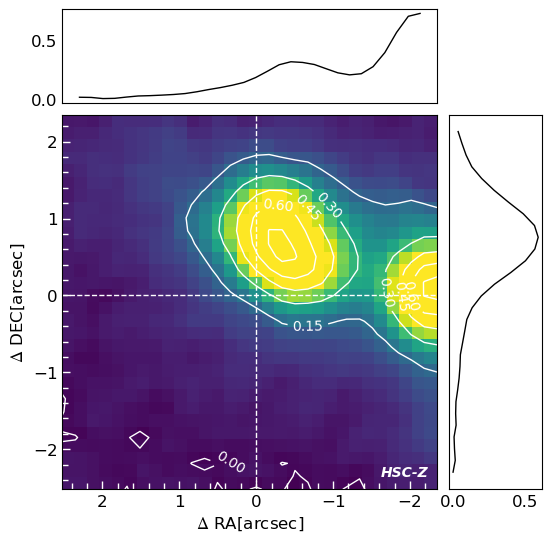

...

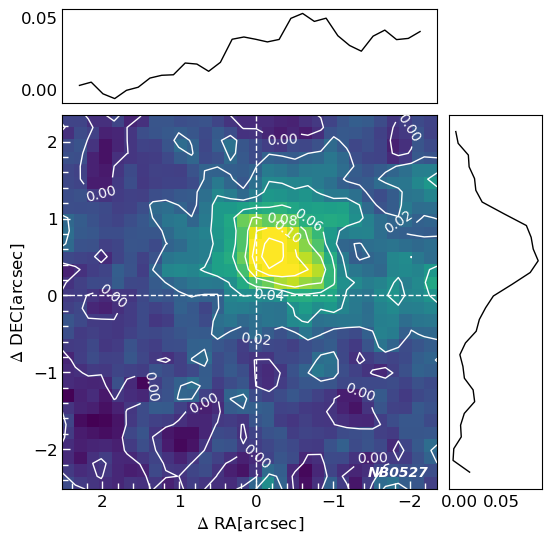

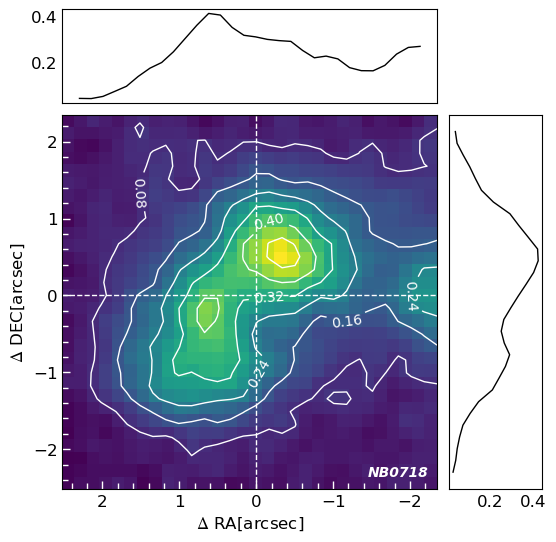

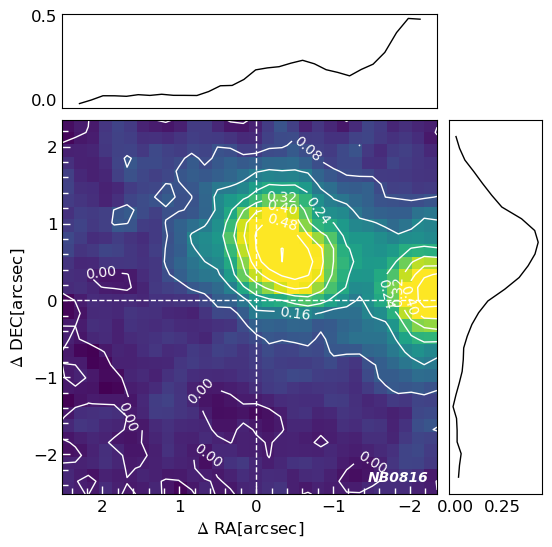

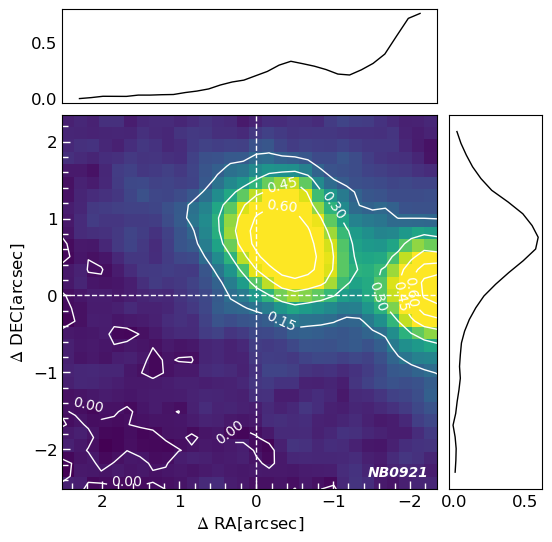

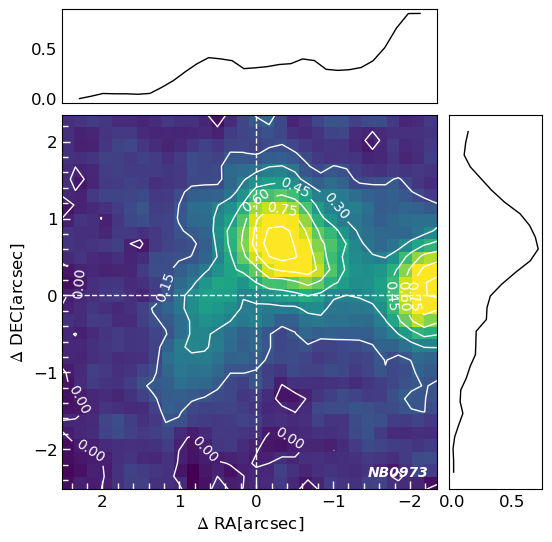

In [24]:
for band in valid_band['SUBARU']:
    # Start with a square Figure.
    fig = plt.figure(figsize=(6, 6))
    # Add a gridspec with two rows and two columns and a ratio of 1 to 4 between
    # the size of the marginal axes and the main axes in both directions.
    # Also adjust the subplot parameters for a square plot.
    gs = fig.add_gridspec(2, 2,  width_ratios=(4, 1), height_ratios=(1, 4),
                          left=0.1, right=0.9, bottom=0.1, top=0.9,
                          wspace=0.05, hspace=0.05)
    # Create the Axes.
    ax_img = fig.add_subplot(gs[1, 0])
    ax_x = fig.add_subplot(gs[0, 0])
    ax_y = fig.add_subplot(gs[1, 1])
    #plot
    plot_1D_curve(band, coords, size, ax_img, ax_x, ax_y, lineflux=False)
    plt.savefig(f'E:/THU/OII_emitter/intensity_map/intensity_map_{band}_v1.png')
    plt.show()

## SUBARU cutout

In [56]:
def subaru_source_coutout(band, coords, size, ax, plotfig=True):
    'Band: HSC-G, HSC-I, HSC-R, HSC-Y, HSC-Z, IB0945, NB0387, NB0527, NB0718, NB0816, NB0921, NB0973'
    datapath= 'E:/THU/OII_emitter/data/SUBARU/'
    with fits.open(glob(f'{datapath}/*{band}*/calexp*{band}*.fits')[0]) as hdu:
        data = hdu[1].data
        header = hdu[1].header
        wcs = WCS(hdu[1].header)
    cutout = Cutout2D(data, position=coords, size=size, wcs=wcs)
    if plotfig:
        extent = np.concatenate([(np.array(cutout.bbox_cutout[0])-cutout.position_cutout[0])*header['CD1_1']*3600, (np.array(cutout.bbox_cutout[1])-cutout.position_cutout[1])*header['CD2_2']*3600])
        norm = ImageNormalize(cutout.data, interval=ZScaleInterval())
        ax.imshow(cutout.data, norm=norm, extent=extent, origin='lower')
        ax.set_xlabel('$\Delta$ RA[arcsec]')
        ax.set_ylabel('$\Delta$ DEC[arcsec]')
    return cutout.data

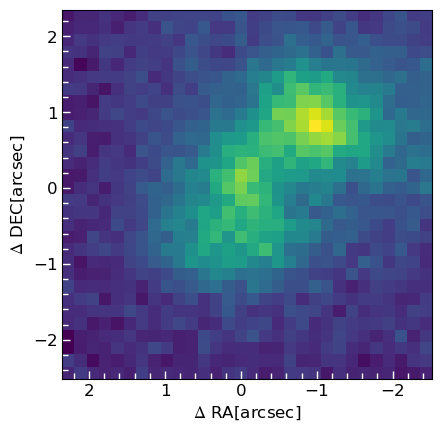

In [57]:
coords = SkyCoord('10:00:38.354 +02:11:28.198', frame='icrs', unit=(u.hourangle, u.deg))
size = 5*u.arcsec
band = 'NB0718'
ax = plt.subplot(1,1,1)
subaru_source_coutout(band, coords, size, ax)
plt.show()

In [8]:
from astropy.io import fits
from glob import glob
with fits.open('/home/lupengjun/OII_emitter/data/image/COSMOS-Web/cutout-f115w-f150w-f200w.fits') as hdu:
    hdu.info()
    data = hdu['F115W-CLEAR', 'WHT'].data


Filename: /home/lupengjun/OII_emitter/data/image/COSMOS-Web/cutout-f115w-f150w-f200w.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  F115W-CLEAR  SCI PrimaryHDU      87   (2400, 2400)   float32   
  1  F115W-CLEAR  WHT ImageHDU        88   (2400, 2400)   float32   
  2  F150W-CLEAR  SCI ImageHDU        88   (2400, 2400)   float32   
  3  F150W-CLEAR  WHT ImageHDU        88   (2400, 2400)   float32   
  4  F200W-CLEAR  SCI ImageHDU        71   (2400, 2400)   float32   
  5  F200W-CLEAR  WHT ImageHDU        71   (2400, 2400)   float32   


## plot filter transmission curve

In [61]:
def plot_filter_wavelength(trans_file, z, ax, range_mode='filter', length=8000,):
    emission_lines = {'$OVI$':1033.82, '$Ly\\alpha$':1215.24, '$NV$':1240.81, '$OI$':1305.53, '$CII$':1335.31, '$SiIV$': 1397.61, '$OIV$': 1399.8, '$CIV$':1549.48, '$HeII$':1640.4, '$OIII$':1665.85, 
                      '$AlIII$':1857.4, '$CIII$':1908.734, '$CII$':2326.0, '$NeIV$':2439.5, '$MgII$':2799.117, '$NeV$':3346.79, '$NeVI$': 3426.85, '$OII$':3727.09, '$OII$':3729.88, '$HeI$':3889.0, 
                     '$SII$':4072.3, '$H\Delta$':4102.89, '$H\gamma$':4341.68, '$OIII$':4364.44, '$OIII$':4960.30, '$OIII$':5008.24, '$OI$':6302.05, '$OI$':6365.54, '$NI$':6529.03, '$NII$':6549.86, 
                      '$H\\alpha$':6564.61, '$NII$':6585.27, '$SII$':6718.29,'$SII$':6732.67}
    trans_curve = np.loadtxt(trans_file)
    wave_min, wave_max = trans_curve[:,0].min(), trans_curve[:,0].max()
    wave_c = (trans_curve[:,0]*trans_curve[:,1]).sum()/trans_curve[:,1].sum()
    if range_mode == 'filter':
        x_min = wave_c - 1.5*(wave_c - wave_min)
        x_max = wave_c + 1.5*(wave_max - wave_c)
    elif range_mode == 'fixed':
        x_min = wave_c - 0.5*length
        x_max = wave_c + 0.5*length       
    emission_lines_array = np.array(list(emission_lines.values()))
    emission_names_array = np.array(list(emission_lines.keys()))
    emission_lines_array_shift = emission_lines_array*(1+z)
    visible_ind = np.where((emission_lines_array_shift>x_min)&(emission_lines_array_shift<x_max))[0]
    visible_lines = emission_lines_array_shift[visible_ind]
    visible_names = emission_names_array[visible_ind]
    #print(emission_lines['OIII1'])
    #plot emission lines
    ax.vlines(visible_lines, 0, 1, colors='r', linestyle='dashed',)
    for i, (x, text) in enumerate(zip(visible_lines, visible_names)):
        if i%2 == 1:
            ax.text(x, 0.8, text, fontsize=10)
        else:
            ax.text(x, 1, text, fontsize=10)
    #plot filter curves
    ax.plot(trans_curve[:,0], trans_curve[:,1])
    ax.fill_between(trans_curve[:,0], trans_curve[:,1], facecolor='lightblue')
    
    ax.set_ylim(0,1.05)
    ax.set_xlim(x_min, x_max)
    #ax.set_title(trans_file.split('/')[-1])
    ax.set_xlabel('Wavelength(A)')
    #plt.show()

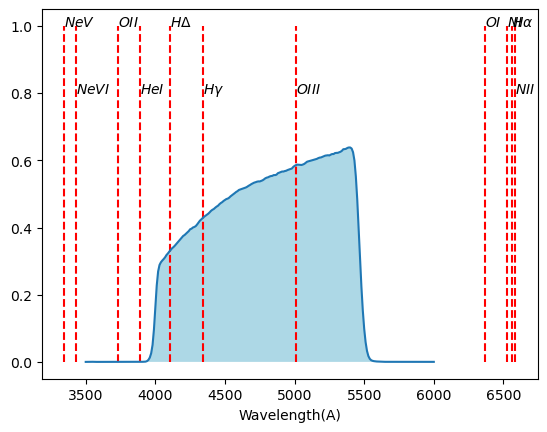

In [85]:
plot_filter_wavelength('E:/THU/OII_emitter/data/filter/SUBARU/g_HSC.txt', 0.924,)

In [45]:
for telescope in os.listdir('E:/THU/OII_emitter/data/filter'):
    for trans_file in os.listdir('E:/THU/OII_emitter/data/filter/%s'%telescope):
        #print(trans_file)
        plot_filter_wavelength('E:/THU/OII_emitter/data/filter/%s/%s'%(telescope, trans_file), 0.924,)

TypeError: plot_filter_wavelength() missing 1 required positional argument: 'ax'

## source cutout with band curve

In [62]:
def source_cutout(data, header, coords, size, ax, showfig=True):
    wcs = WCS(header)
    cutout = Cutout2D(data, position=coords, size=size, wcs=wcs)
    if showfig:
        try:
            extent = np.concatenate([(np.array(cutout.bbox_cutout[0])-cutout.position_cutout[0])*header['CD1_1']*3600, (np.array(cutout.bbox_cutout[1])-cutout.position_cutout[1])*header['CD2_2']*3600])
        except:
            extent = np.concatenate([(np.array(cutout.bbox_cutout[0])-cutout.position_cutout[0])*header['CDELT1']*3600, (np.array(cutout.bbox_cutout[1])-cutout.position_cutout[1])*header['CDELT2']*3600])                
        norm = ImageNormalize(cutout.data, interval=ZScaleInterval())
        ax.imshow(cutout.data, norm=norm, extent=extent, origin='lower')
        ax.set_xlabel('$\Delta$ RA[arcsec]')
        ax.set_ylabel('$\Delta$ DEC[arcsec]')
    return cutout.data

In [7]:
valid_band = {'HST':['F606W', 'F814W', 'F125W', 'F160W'],'JWST':['F115W', 'F150W', 'F277W', 'F444W'], 'SUBARU':['HSC-G','HSC-I','HSC-R','HSC-Y','HSC-Z','IB0945','NB0387','NB0527','NB0718','NB0816','NB0921','NB0973'],
             'CFHT':['H','i','Ks','u'], 'SPITZER':['ch1','ch2','ch3','ch4'], 'GEMINI':['Ks'], 'UKIRT':['J'], 'VISTA':['H','J','Ks','Y','NB118']}

In [82]:
def plot_band_image(telescope, band, coords, size):

    if telescope == 'HST':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/candels_cutouts/'
        with fits.open(glob(path+f'*{band.lower()}*.fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'JWST':
        path = 'E:/THU/OII_emitter/data/COSMOS-Webb-4bands/'
        with fits.open(path+'cutout-fits-1392.fits') as hdu:
            data = hdu[f'{band.upper()}-CLEAR'].data
            header = hdu[f'{band.upper()}-CLEAR'].header
    elif telescope == 'SUBARU':
        path = 'E:/THU/OII_emitter/data/SUBARU/'
        with fits.open(glob(path+f'{band}*/calexp-{band}*.fits')[0]) as hdu:
            data = hdu[1].data
            header = hdu[1].header
    elif telescope == 'CFHT':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/cfht_mosaics/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'SPITZER':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/irac_sci/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'GEMINI':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/kpno_mosaics/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'UKIRT':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/ukirt_mosaics/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'VISTA':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/ultravista_sci/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    #plot
    fig = plt.figure(figsize=(12, 5))  # Adjust the figure size as needed
    # Create a 1x2 grid for subplots
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2])
#     gs.update(wspace=0.1)  # Adjust the width spacing between subplots
#     gs.update(left=0.1, right=0.9, top=0.9, bottom=0.1)  # Adjust margins    
    
    # Add subplots to the grid
    ax1 = plt.subplot(gs[0])
    ax2 = plt.subplot(gs[1])
    
    #fig, (ax1, ax2) = plt.subplots(1,2, gridspec_kw=dict(width_ratios=[1, 3],), figsize=(12, 5))
    source_cutout(data, header, coords, size, ax=ax1)
    
    trans_file = glob(f'E:/THU/OII_emitter/data/filter/{telescope}/*{band}*')[0]
    plot_filter_wavelength(trans_file, z=0.924, ax=ax2, range_mode='fixed')
    
    plt.suptitle(f'{telescope}   {band}')    

    plt.tight_layout()
    plt.savefig(f'E:/THU/OII_emitter/band_image/{telescope}_{band}.png')
    plt.show()

HST F606W


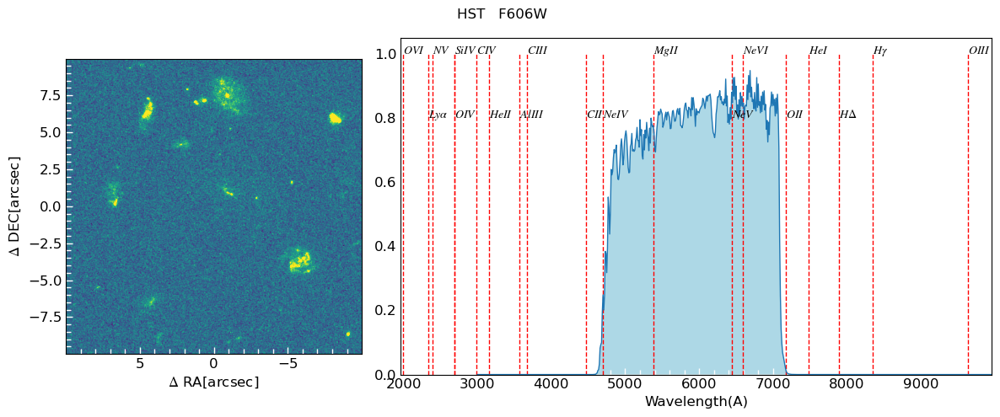

HST F814W


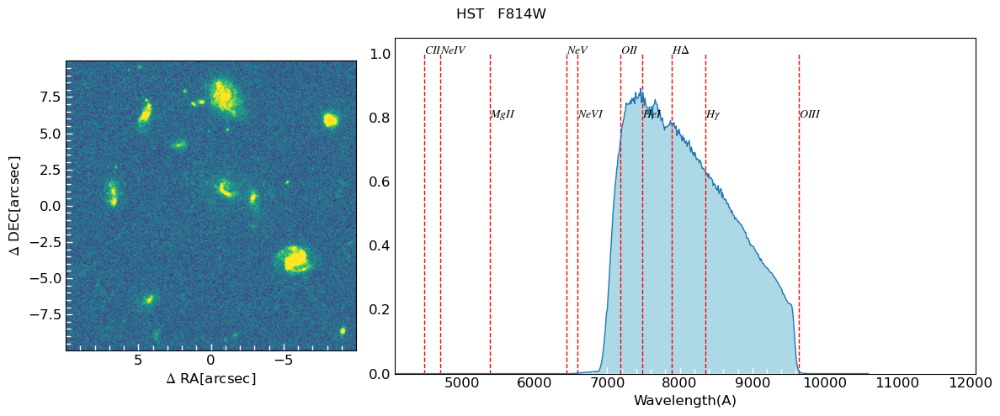

HST F125W
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


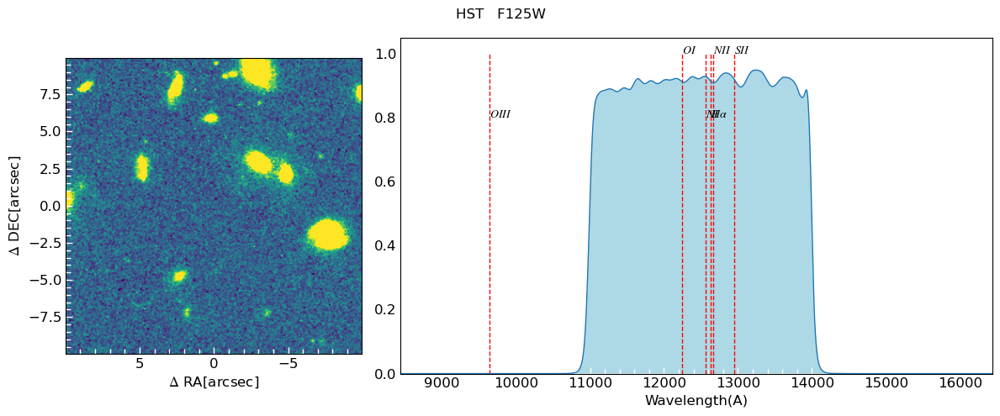

HST F160W
INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


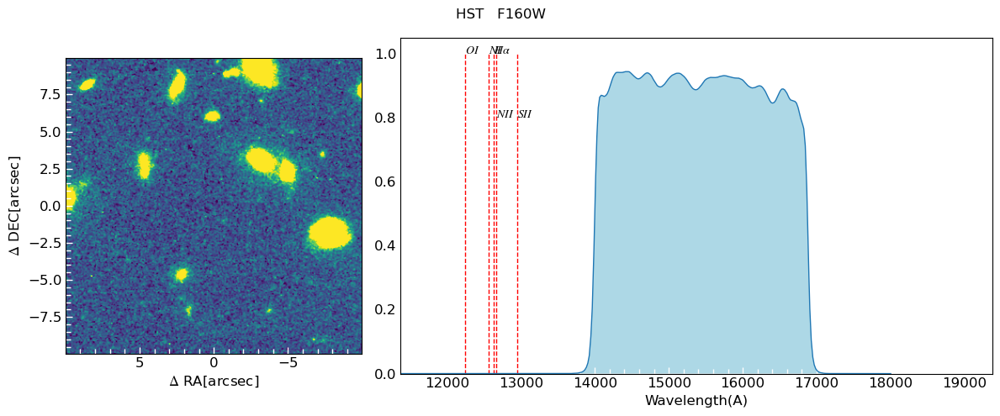

JWST F115W


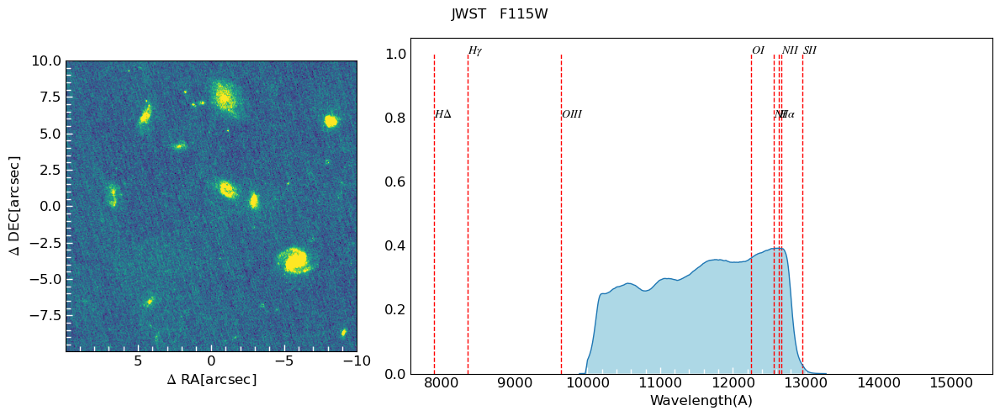

JWST F150W


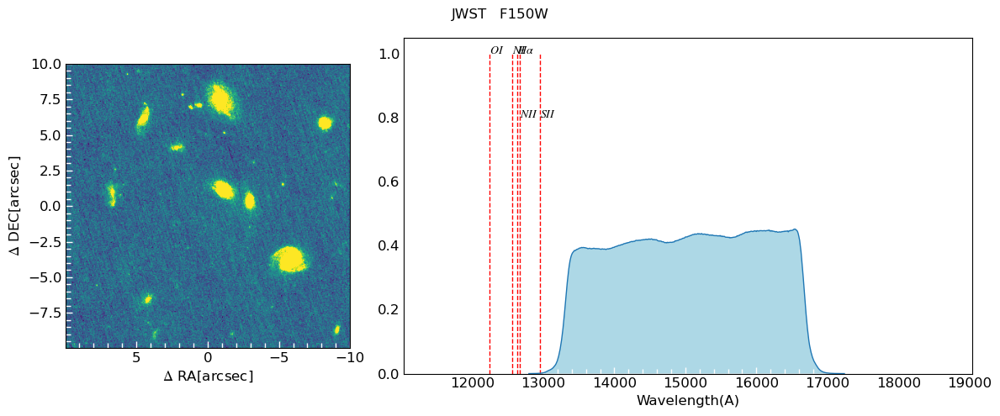

JWST F277W


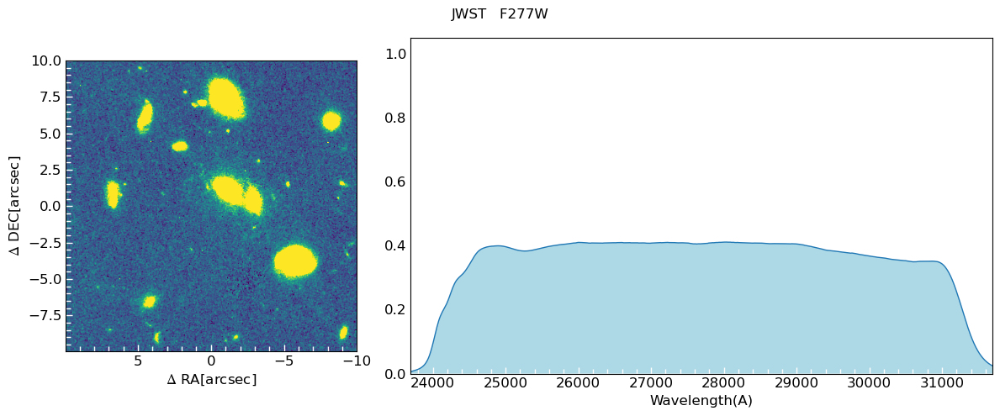

JWST F444W


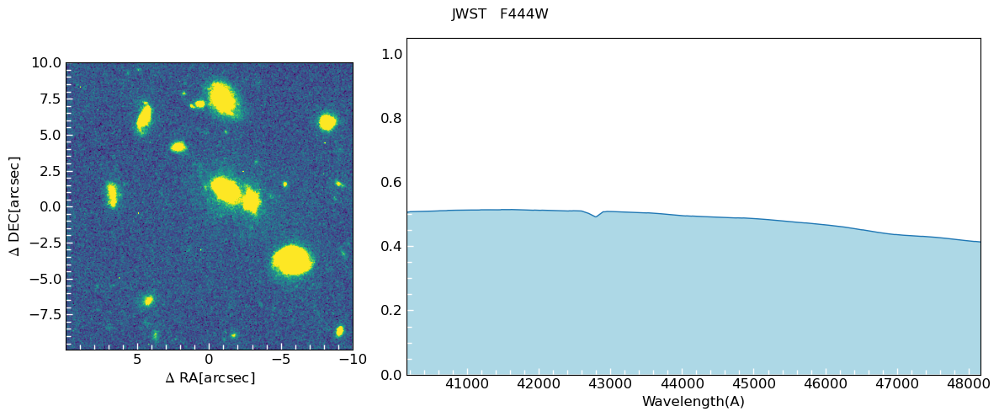

SUBARU HSC-G


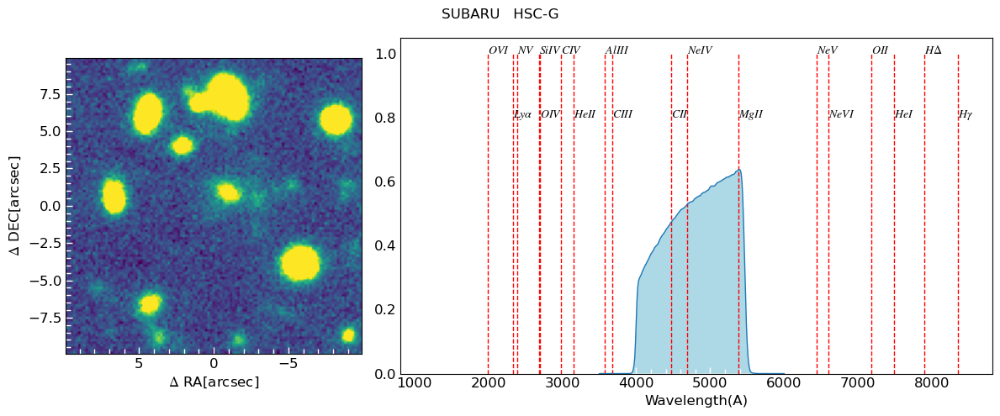

SUBARU HSC-I


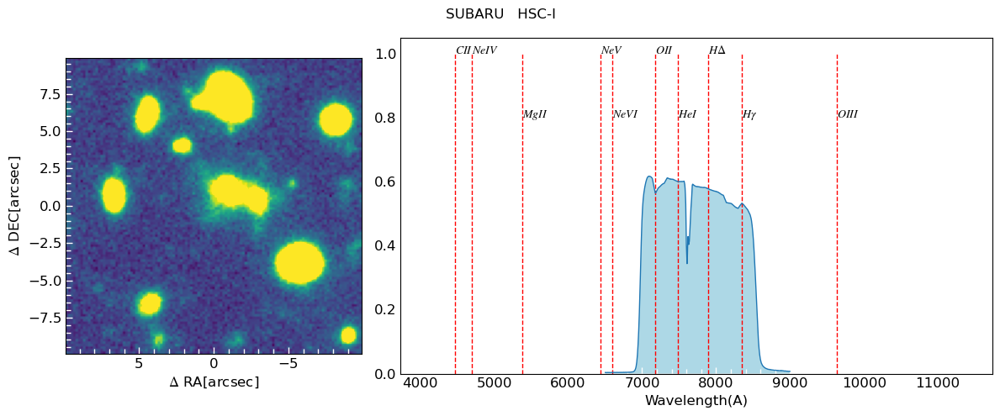

SUBARU HSC-R


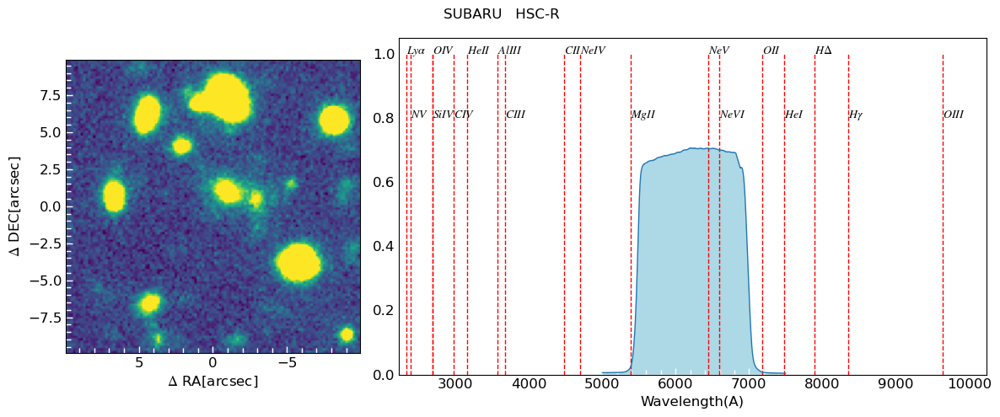

SUBARU HSC-Y


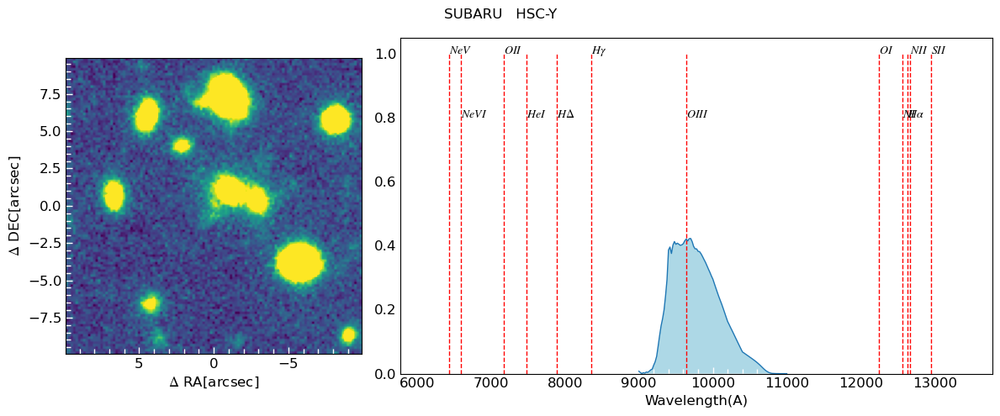

SUBARU HSC-Z


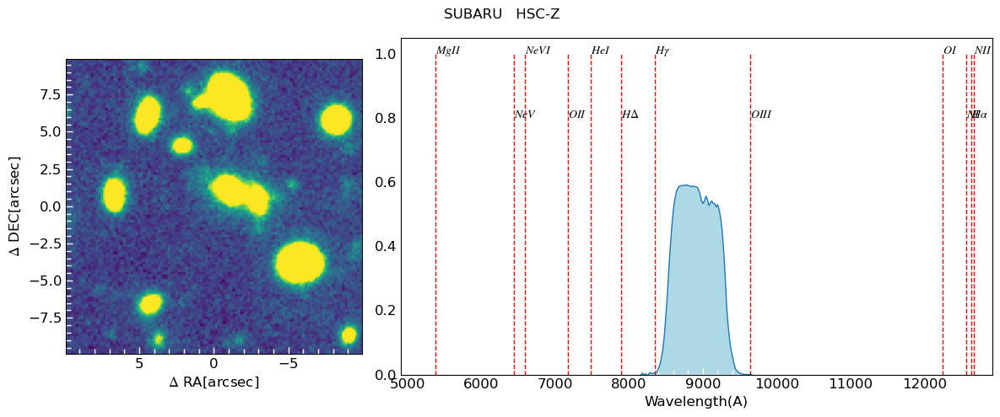

SUBARU IB0945


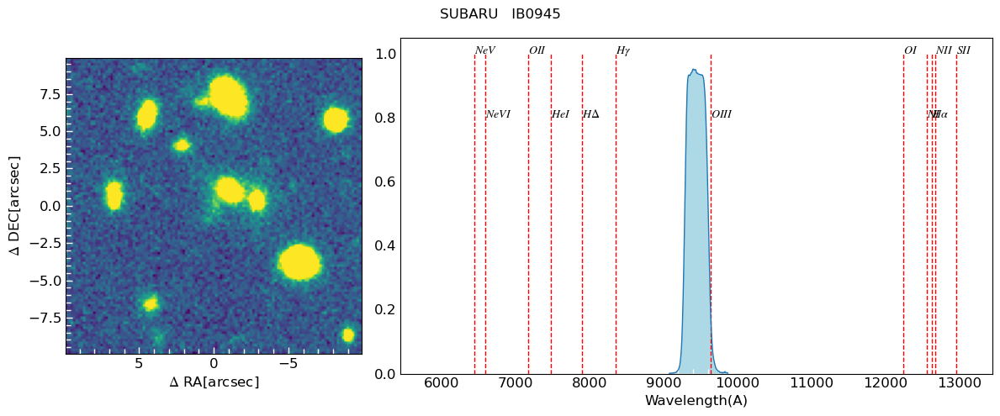

SUBARU NB0387


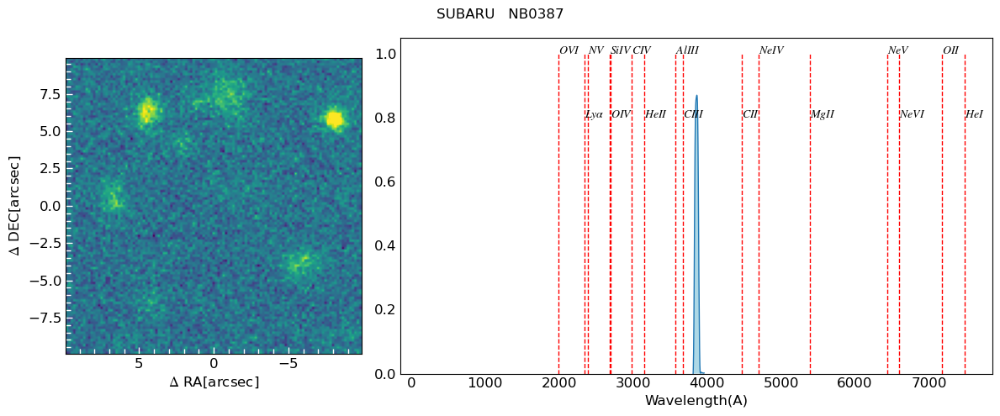

SUBARU NB0527


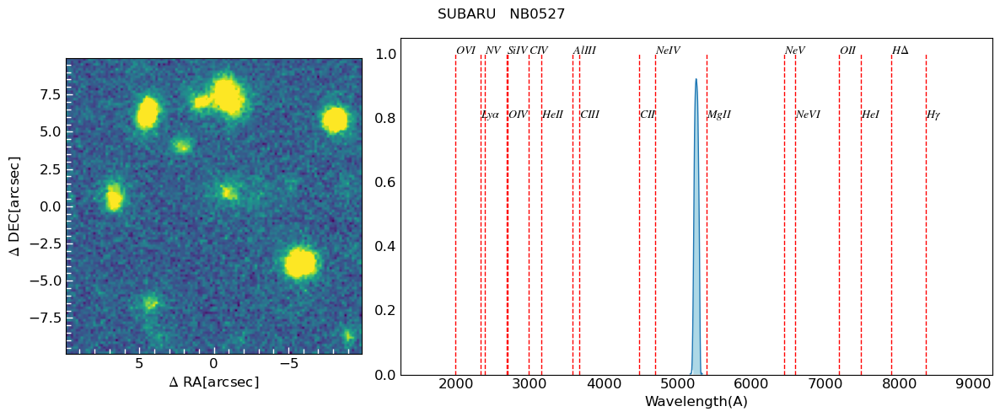

SUBARU NB0718


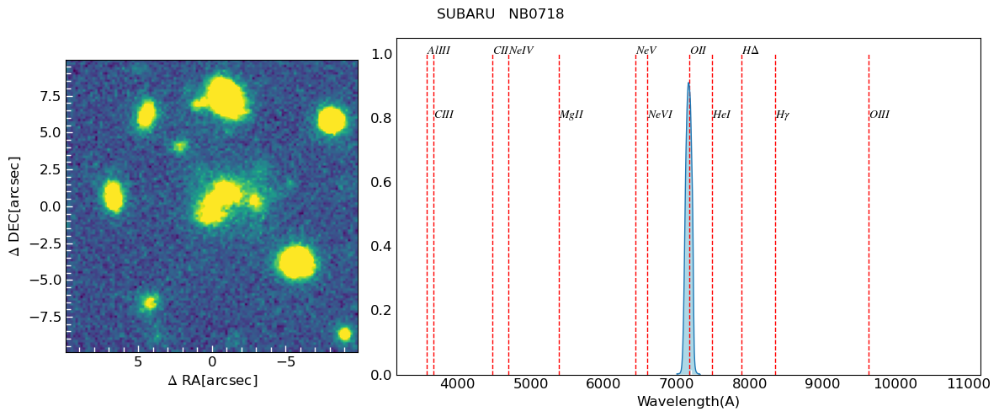

SUBARU NB0816


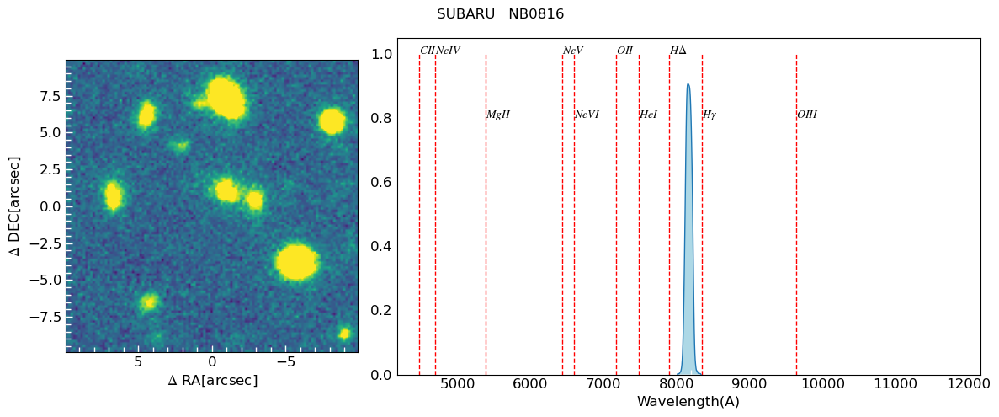

SUBARU NB0921


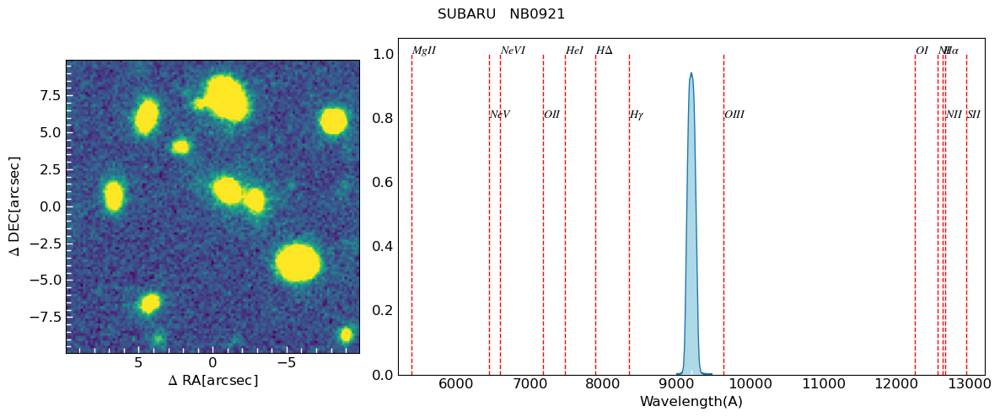

SUBARU NB0973


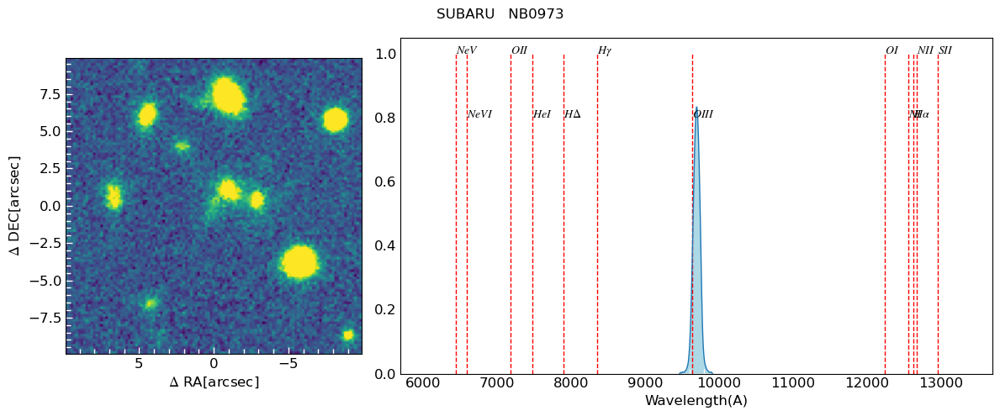

CFHT H


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


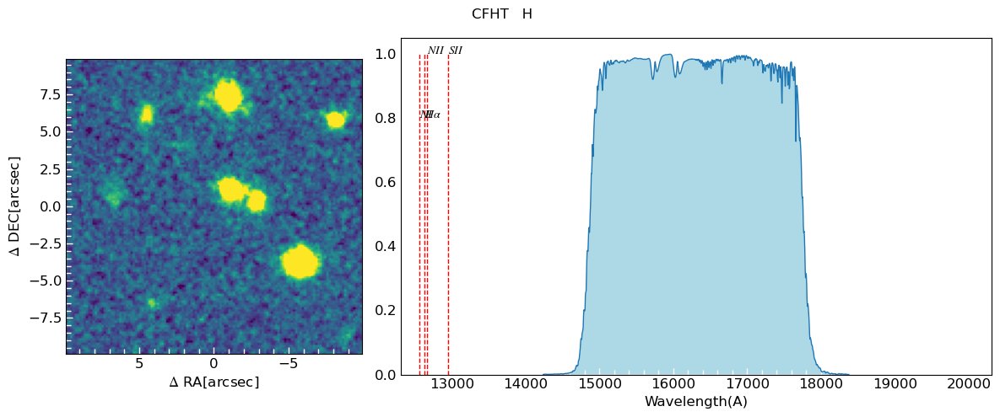

CFHT i


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


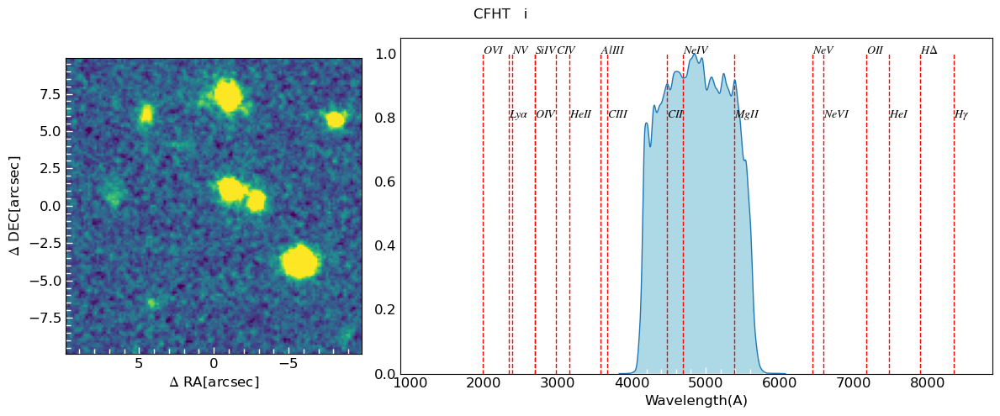

CFHT Ks


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


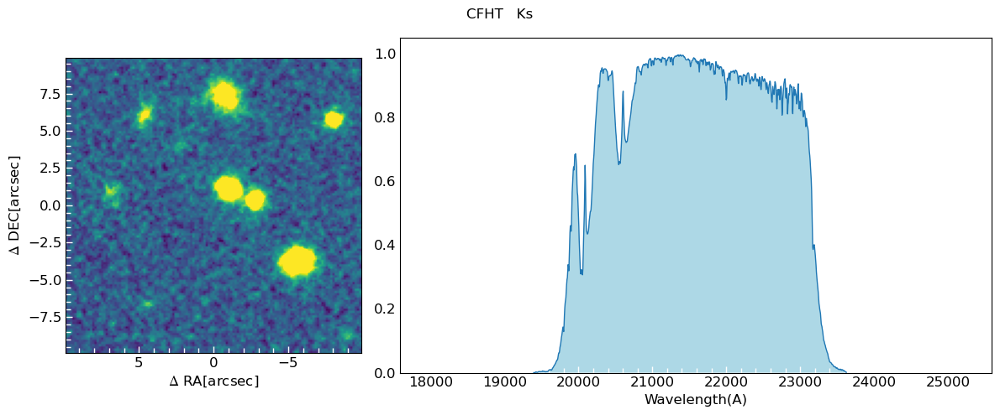

CFHT u


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


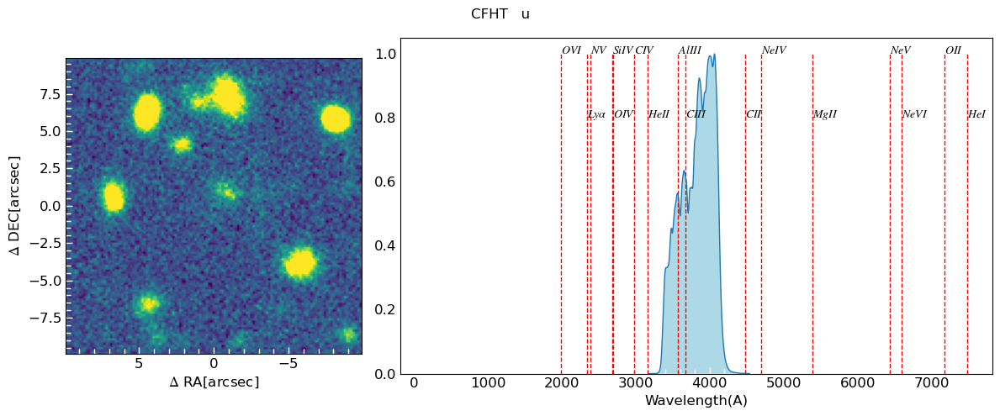

SPITZER ch1


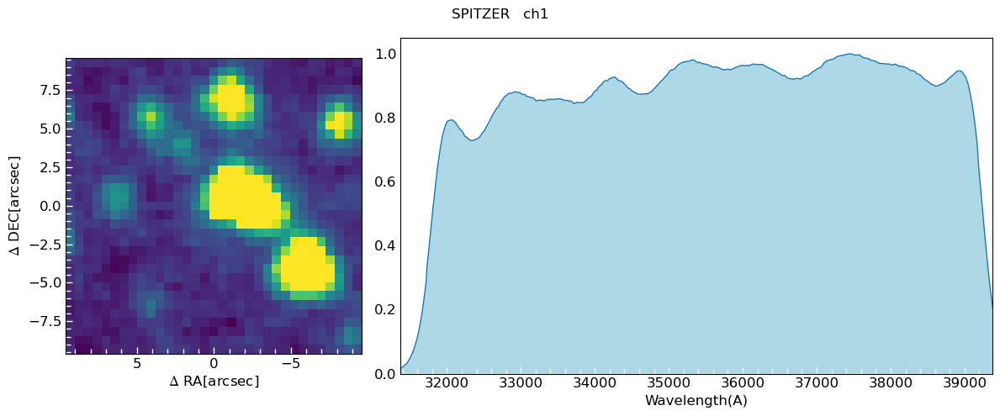

SPITZER ch2


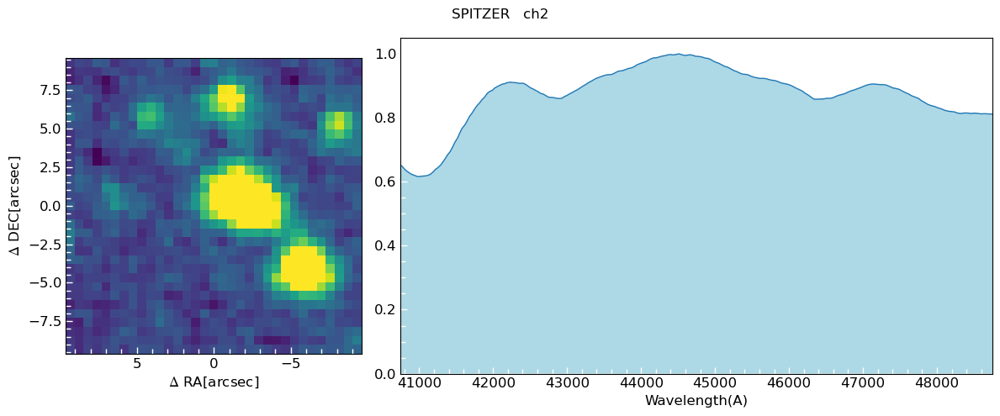

SPITZER ch3


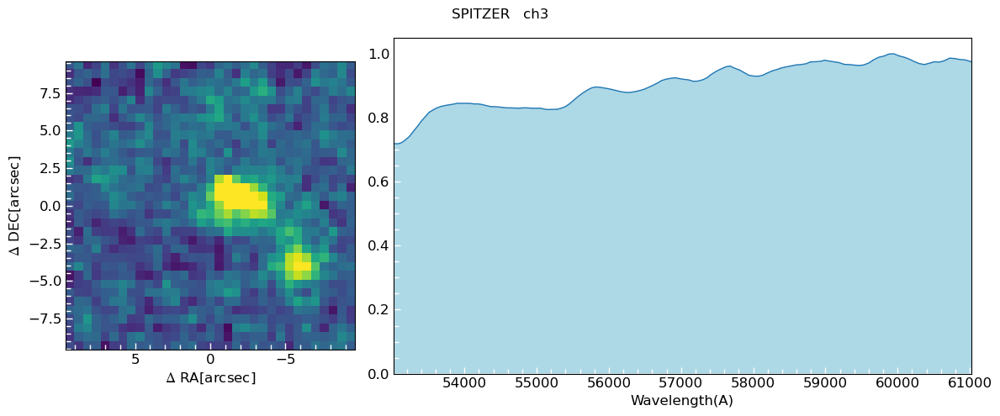

SPITZER ch4


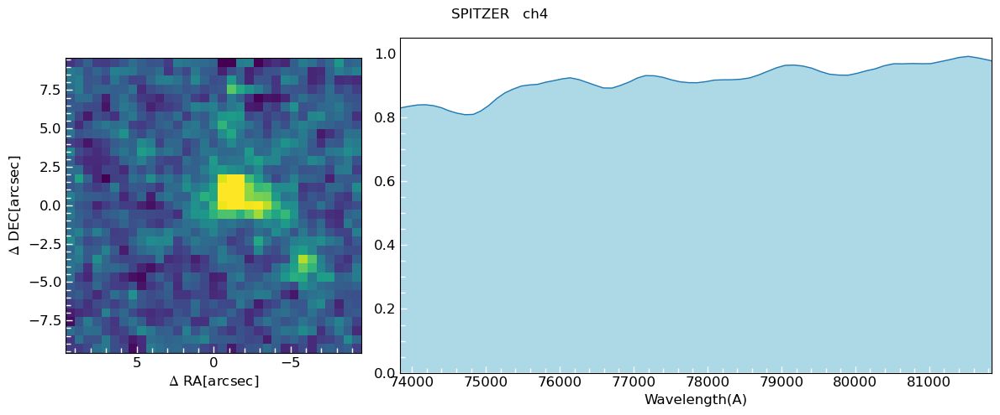

GEMINI Ks


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


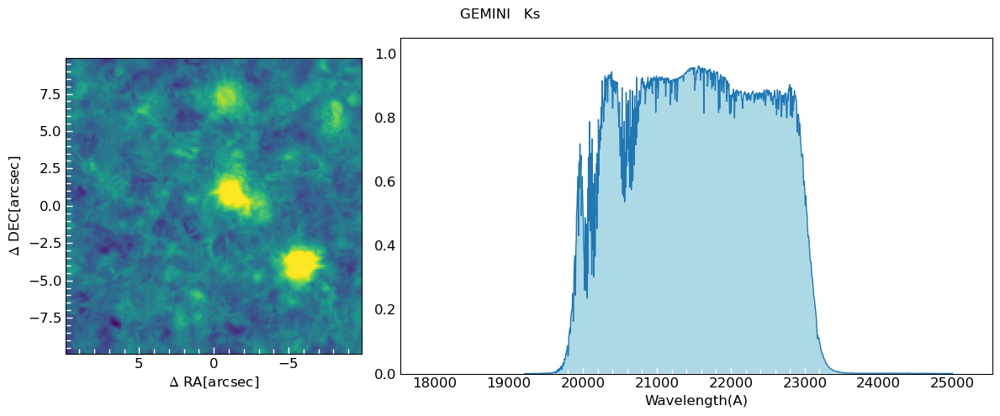

UKIRT J


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


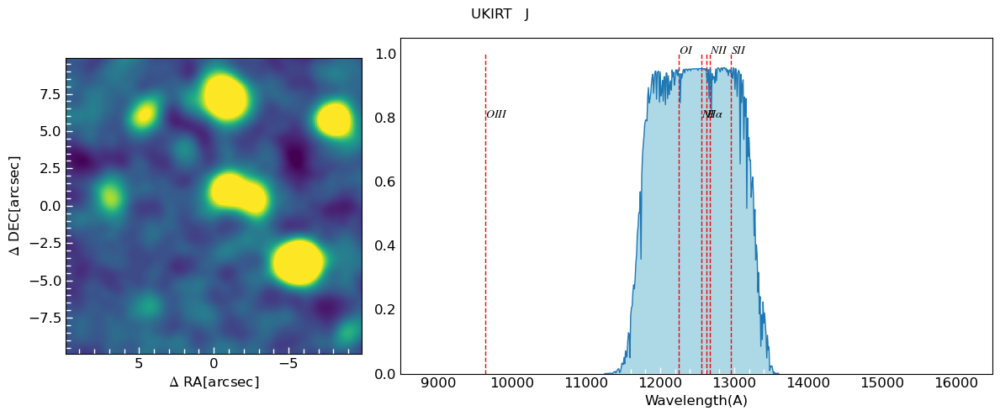

VISTA H


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-06-04T00:47:19.488' from MJD-END'. [astropy.wcs.wcs]


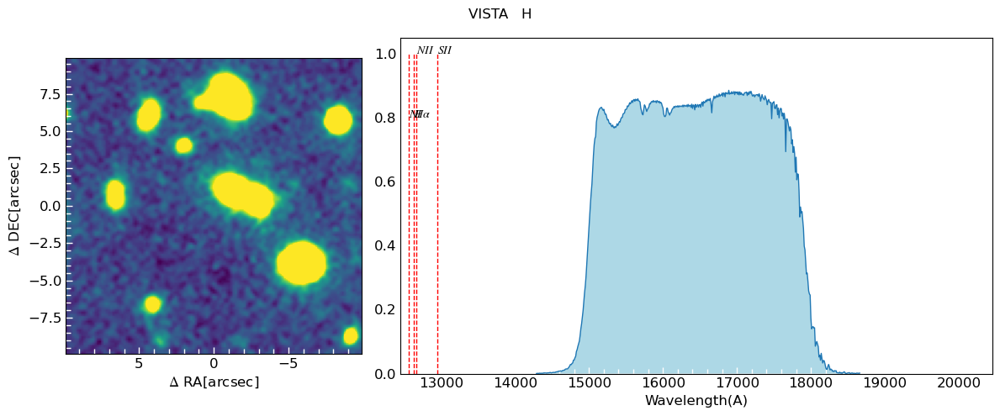

VISTA J


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-05-03T03:37:16.477' from MJD-END'. [astropy.wcs.wcs]


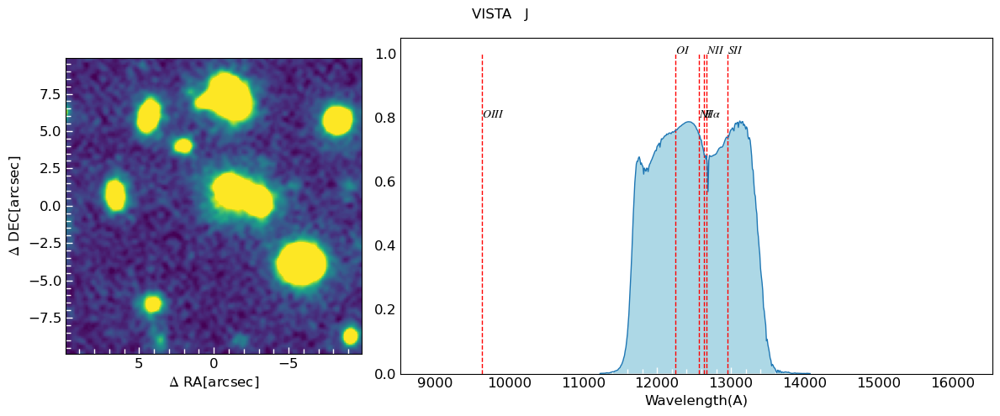

VISTA Ks


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-06-29T23:52:46.677' from MJD-END'. [astropy.wcs.wcs]


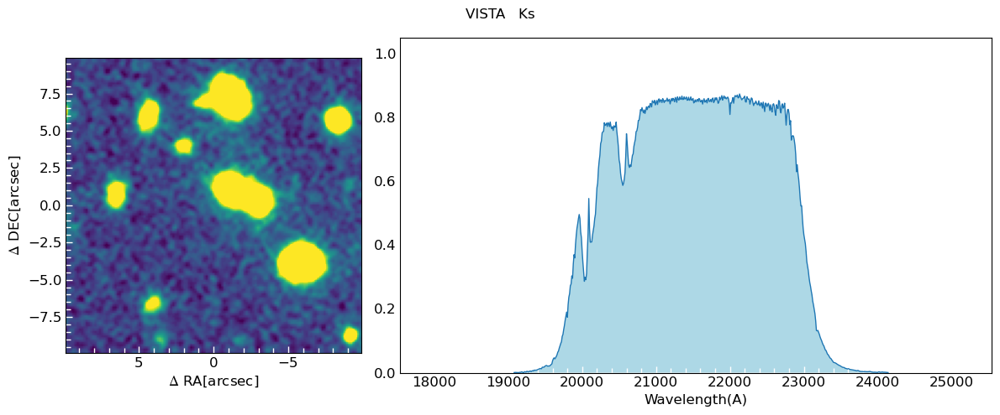

VISTA Y


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-06-04T00:47:19.488' from MJD-END'. [astropy.wcs.wcs]


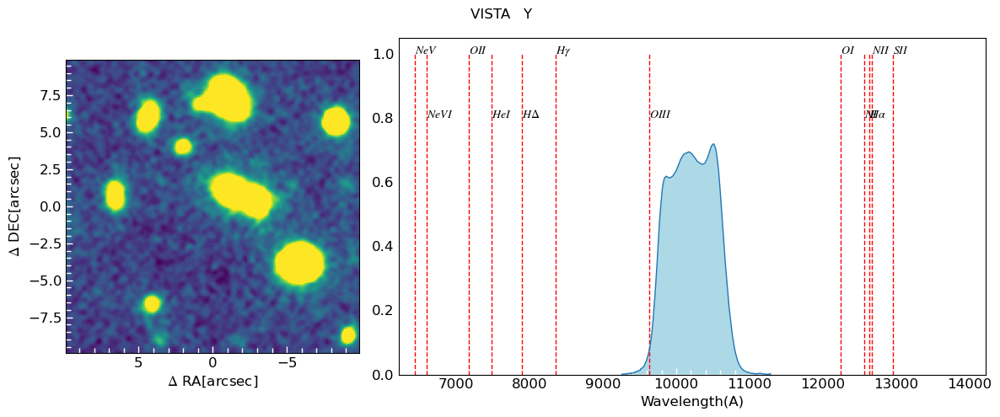

VISTA NB118


the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-04-30T03:11:04.794' from MJD-END'. [astropy.wcs.wcs]


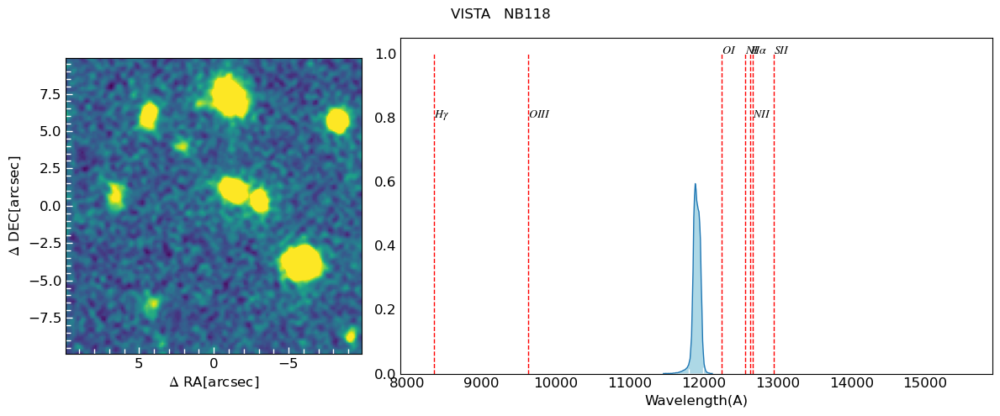

In [83]:
coords = SkyCoord('10:00:38.354 +02:11:28.198', frame='icrs', unit=(u.hourangle, u.deg))
size = 20*u.arcsec
for k in valid_band.keys():
    for band in valid_band[k]:
        print(k, band)
        plot_band_image(k, band,coords, size)

## spectra data

C:\Users\Sunny\AppData\Local\Temp\ipykernel_10828\1747816987.py:9: RuntimeWarning: divide by zero encountered in true_divide
  error = 1 / (ivar ** 0.5)


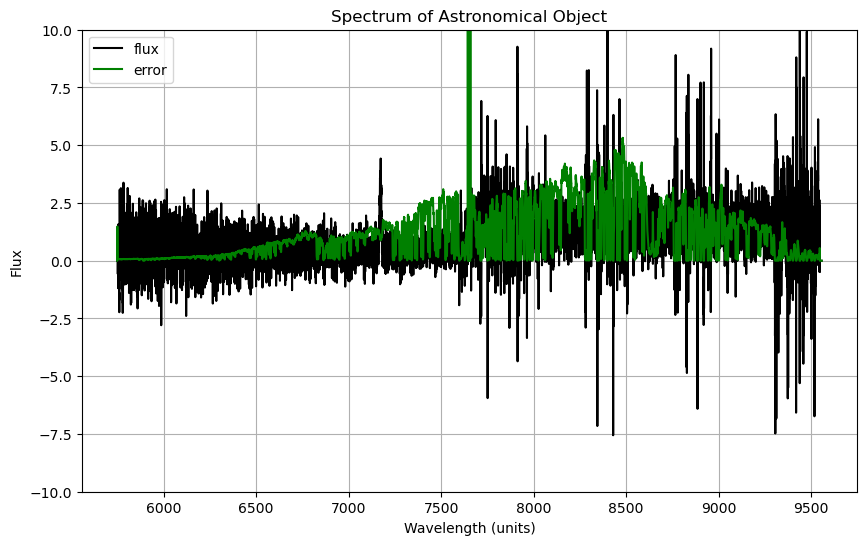

In [20]:
with fits.open('E:/THU/OII_emitter/data/spectra/spec1d.COS-31.059.JK_70_1519_acal.fits') as hdu:
    flux = hdu[1].data['FLUX']
    ivar = hdu[1].data['IVAR']
    wavelengths = hdu[1].data['LAMBDA']
    header0 = hdu[0].header
    header1 = hdu[1].header

# Calculate the error (standard deviation) from the inverse variance
error = 1 / (ivar ** 0.5)

# Plot the spectrum
plt.figure(figsize=(10, 6))
#plt.errorbar(wavelengths[0], flux[0], yerr=error[0], color='lightblue')
plt.plot(wavelengths[0], flux[0], color='k', label='flux')
plt.plot(wavelengths[0], ivar[0], color='green', label='error')
plt.xlabel('Wavelength (units)')
plt.ylabel('Flux')
plt.ylim(-10,10)
plt.title('Spectrum of Astronomical Object')
plt.legend()
plt.grid(True)

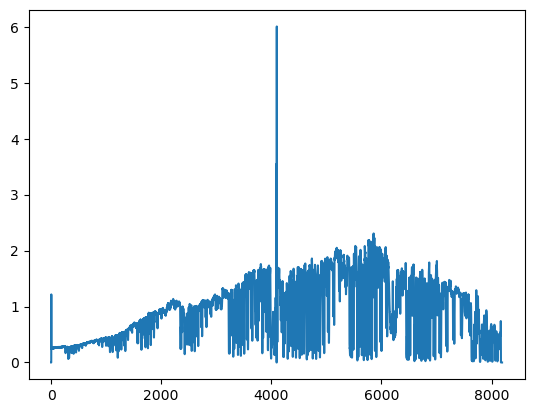

In [28]:
plt.plot(ivar[0]**0.5)
#plt.plot(error[0])

In [8]:
flux[0]

array([0., 0., 0., ..., 0., 0., 0.])

In [17]:
header1

XTENSION= 'BINTABLE'           /Binary table written by MWRFITS v1.6a           
BITPIX  =                    8 /Required value                                  
NAXIS   =                    2 /Required value                                  
NAXIS1  =               196608 /Number of bytes per row                         
NAXIS2  =                    1 /Number of rows                                  
PCOUNT  =                    0 /Normally 0 (no varying arrays)                  
GCOUNT  =                    1 /Required value                                  
TFIELDS =                    3 /Number of columns in table                      
COMMENT                                                                         
COMMENT  *** End of mandatory fields ***                                        
COMMENT                                                                         
COMMENT                                                                         
COMMENT  *** Column names **

In [18]:
# Column names
column_names = ['wavelength', 'intensity', 'error']

# Combine data into a single array
data = np.column_stack((wavelengths[0], flux[0], error[0]))

# Save to CSV file
csv_filename = 'gal_spectra.csv'
np.savetxt(csv_filename, data, delimiter=',', header=','.join(column_names), comments='')

In [21]:
header0

SIMPLE  =                    T /Dummy Created by MWRFITS v1.6a                  
BITPIX  =                    8 /Dummy primary header created by MWRFITS         
NAXIS   =                    0 /No data is associated with this header          
EXTEND  =                    T /Extensions may (will!) be present               

In [32]:
hdu = fits.open('E:/THU/OII_emitter/data/spectra/spec2d.COS-31.059.JK_70_1519.fits')

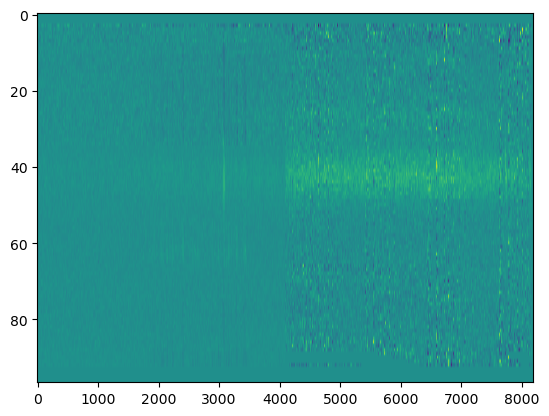

In [40]:
norm = ImageNormalize(hdu[1].data['flux'][0], interval=ZScaleInterval())
plt.imshow(hdu[1].data['flux'][0], aspect='auto', norm=norm)

## muti-band photometry

322-90 = 232

In [57]:
positions = SkyCoord('10:00:38.283 +2:11:29.33', frame='icrs', unit=(u.hourangle, u.deg))
elp_v1 = SkyEllipticalAperture(positions, a=1.2609045*u.arcsec, b=0.95159205*u.arcsec, theta=232*u.degree)

In [62]:
phot_table = aperture_photometry(img_cutout.data, elp_v1, wcs=img_cutout.wcs)
phot_table['aperture_sum'].info.format = '%.8g'  # for consistent table output
phot_table['aperture_sum'][0]

51.72251537108585

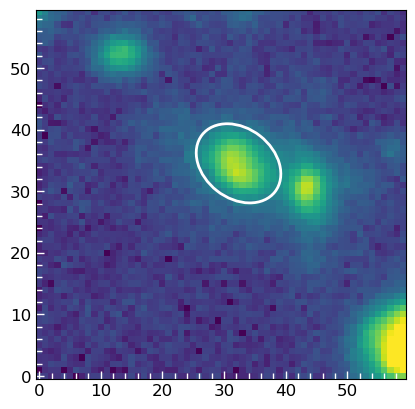

In [8]:
norm = simple_norm(img_cutout.data, 'sqrt', percent=99)
ax = plt.subplot(1,1,1)
ax.imshow(img_cutout.data, norm=norm, interpolation='nearest', origin='lower')
ap_patches = elp_v1.to_pixel(wcs=img_cutout.wcs).plot(ax, color='white', lw=2)

### measure all bands and plot

In [8]:
def multi_band_photometry(telescope, band, aperture, ax, image_size=10*u.arcsec):
    if telescope == 'HST':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/candels_cutouts/'
        with fits.open(glob(path+f'*{band.lower()}*.fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header.copy()
            #remove SIP header with keywords start with A_ and B_
            for keyword in hdu[0].header:
                if (keyword.startswith('A_')) or (keyword.startswith('B_')):
                    del header[keyword]
    elif telescope == 'JWST':
        path = 'E:/THU/OII_emitter/data/COSMOS-Webb-4bands/'
        with fits.open(path+'cutout-fits-1392.fits') as hdu:
            data = hdu[f'{band.upper()}-CLEAR'].data
            header = hdu[f'{band.upper()}-CLEAR'].header
    elif telescope == 'SUBARU':
        path = 'E:/THU/OII_emitter/data/SUBARU/'
        with fits.open(glob(path+f'{band}*/calexp-{band}*.fits')[0]) as hdu:
            data = hdu[1].data
            header = hdu[1].header
    elif telescope == 'CFHT':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/cfht_mosaics/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'SPITZER':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/irac_sci/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'GEMINI':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/kpno_mosaics/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'UKIRT':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/ukirt_mosaics/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'VISTA':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/ultravista_sci/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header

    wcs = WCS(header)
    phot_table = aperture_photometry(data, aperture, wcs=wcs)
    aperture_sum = phot_table['aperture_sum'][0]
    
    cutout = Cutout2D(data, position=aperture.positions, size=image_size, wcs=wcs)

    norm = ImageNormalize(cutout.data, interval=ZScaleInterval())
    ax.imshow(cutout.data, norm=norm, origin='lower')
    xmin, xmax = ax.get_xlim()
    ymin, ymax = ax.get_ylim()    
    
    ax.set_xlabel('$\Delta$ RA[arcsec]')
    ax.set_ylabel('$\Delta$ DEC[arcsec]')
    ax.text(0.95*xmax, 0.95*ymin, f'{telescope} {band}', color='white', ha='right', va='bottom', fontstyle='italic', fontweight='bold')
    aperture.to_pixel(wcs=cutout.wcs).plot(ax, color='white', lw=2)
    aperture_area = aperture.to_pixel(wcs=cutout.wcs).area
    #change pixel coordinate to arcsec
    try:
        new_xticks = (ax.get_xticks()-cutout.position_cutout[0])*header['CD1_1']*3600
        new_yticks = (ax.get_yticks()-cutout.position_cutout[1])*header['CD2_2']*3600
    except:
        new_xticks = (ax.get_xticks()-cutout.position_cutout[0])*header['CDELT1']*3600
        new_yticks = (ax.get_yticks()-cutout.position_cutout[1])*header['CDELT2']*3600    
    ax.set_xticklabels(np.around(new_xticks, 1).astype(str))
    ax.set_yticklabels(np.around(new_yticks, 1).astype(str))
    
    if telescope == 'HST': 
        return aperture_sum*header['PHOTPLAM']**2*header['PHOTFLAM'], aperture_area
    elif telescope == 'SPITZER':
        return aperture_sum*np.abs(np.deg2rad(header['CDELT1'])*np.deg2rad(header['CDELT2']))*aperture_area, aperture_area
    else:
        return aperture_sum, aperture_area

In [24]:
raw_sum_dic['SPITZER']

{'ch1': 3.7588487469812266e-10,
 'ch2': 5.042067369170582e-10,
 'ch3': 2.8718037446116155e-09,
 'ch4': 8.302671370219618e-09}

In [14]:
np.array(list({'a':[1,2], 'b':[2,3,4]}.values())).flatten()

C:\Users\Sunny\AppData\Local\Temp\ipykernel_2204\2953187319.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array(list({'a':[1,2], 'b':[2,3,4]}.values())).flatten()


array([list([1, 2]), list([2, 3, 4])], dtype=object)

C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:70: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(np.around(new_xticks, 1).astype(str))
C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:71: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(np.around(new_yticks, 1).astype(str))
C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:70: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(np.around(new_xticks, 1).astype(str))
C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:71: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(np.around(new_yticks, 1).astype(str))
C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:70: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(np.around(new_xticks, 1).astype(str))


C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:70: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(np.around(new_xticks, 1).astype(str))
C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:71: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(np.around(new_yticks, 1).astype(str))
C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:70: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(np.around(new_xticks, 1).astype(str))
C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:71: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(np.around(new_yticks, 1).astype(str))
C:\Users\Sunny\AppData\Local\Temp\ipykernel_4624\553740667.py:70: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(np.around(new_xticks, 1).astype(str))


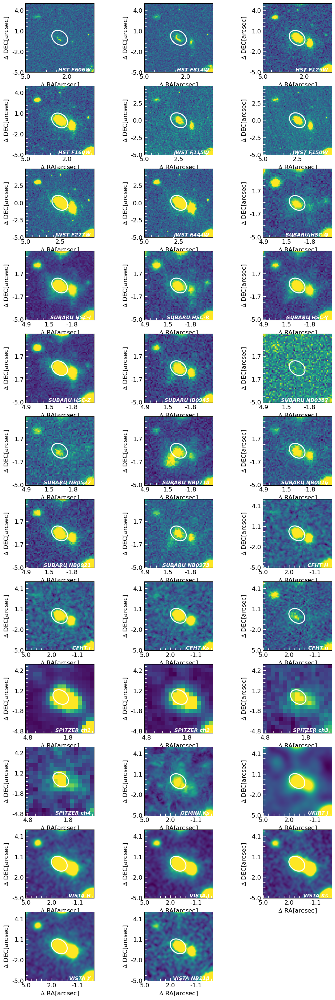

In [9]:
positions = SkyCoord('10:00:38.283 +2:11:29.33', frame='icrs', unit=(u.hourangle, u.deg))
elp_v1 = SkyEllipticalAperture(positions, a=1.2609045*u.arcsec, b=0.95159205*u.arcsec, theta=232*u.degree)

fig = plt.figure(figsize=(12, 35))
gs = fig.add_gridspec(12, 3,)
i = -1
raw_sum_dic = {}
pixel_area_dic = {}
for telescope in valid_band.keys():
    raw_sum_dic[telescope]  = {}
    pixel_area_dic[telescope]  = {}
    for band in valid_band[telescope]:
        i += 1
        ax = fig.add_subplot(gs[i//3, i%3])
        raw_flux, pixel_area = multi_band_photometry(telescope, band, elp_v1, ax)
        raw_sum_dic[telescope][band] = raw_flux
        pixel_area_dic[telescope][band] = pixel_area
plt.savefig('E:/THU/OII_emitter/photometry/multiband-aperture-plot.png')
plt.show()

In [53]:
def bkg_sigma_clip(telescope, band, positions, sigma=3.0, maxit=5, image_size=10*u.arcsec):
    if telescope == 'HST':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/candels_cutouts/'
        with fits.open(glob(path+f'*{band.lower()}*.fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header.copy()
            #remove SIP header with keywords start with A_ and B_
            for keyword in hdu[0].header:
                if (keyword.startswith('A_')) or (keyword.startswith('B_')):
                    del header[keyword]
    elif telescope == 'JWST':
        path = 'E:/THU/OII_emitter/data/COSMOS-Webb-4bands/'
        with fits.open(path+'cutout-fits-1392.fits') as hdu:
            data = hdu[f'{band.upper()}-CLEAR'].data
            header = hdu[f'{band.upper()}-CLEAR'].header
    elif telescope == 'SUBARU':
        path = 'E:/THU/OII_emitter/data/SUBARU/'
        with fits.open(glob(path+f'{band}*/calexp-{band}*.fits')[0]) as hdu:
            data = hdu[1].data
            header = hdu[1].header
    elif telescope == 'CFHT':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/cfht_mosaics/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'SPITZER':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/irac_sci/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'GEMINI':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/kpno_mosaics/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'UKIRT':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/ukirt_mosaics/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    elif telescope == 'VISTA':
        path = 'E:/THU/OII_emitter/data/COSMOS-archive/results/ultravista_sci/'
        with fits.open(glob(path+f'*{band}*fits')[0]) as hdu:
            data = hdu[0].data
            header = hdu[0].header
    
    if telescope == 'HST' or telescope == 'JWST': sigma = 4 #space telescopes have higher sensitivity so that some background is brighter?
    sigclip = SigmaClip(sigma=sigma, maxiters=maxit)
    filtered_data = sigclip(data, masked=True) 

    
    wcs = WCS(header)
    cutout_data = Cutout2D(data, position=positions, size=image_size, wcs=wcs)
    cutout_bkg = Cutout2D(filtered_data, position=positions, size=image_size, wcs=wcs)
    #cutout_mask = Cutout2D(filtered_mask, position=positions, size=image_size, wcs=wcs)
    
    norm = ImageNormalize(cutout_data.data, interval=ZScaleInterval())
        
    try:
        extent = np.concatenate([(np.array(cutout_data.bbox_cutout[0])-cutout_data.position_cutout[0])*header['CD1_1']*3600, (np.array(cutout_data.bbox_cutout[1])-cutout_data.position_cutout[1])*header['CD2_2']*3600])
    except:
        extent = np.concatenate([(np.array(cutout_data.bbox_cutout[0])-cutout_data.position_cutout[0])*header['CDELT1']*3600, (np.array(cutout_data.bbox_cutout[1])-cutout_data.position_cutout[1])*header['CDELT2']*3600])                

    fig = plt.figure(figsize=(12,5))
    ax1, ax2 = fig.subplots(1,2)
    
    ax1.imshow(cutout_data.data, norm=norm, extent=extent, origin='lower')
    xmin, xmax = ax1.get_xlim()
    ymin, ymax = ax1.get_ylim()    
    
    ax1.set_xlabel('$\Delta$ RA[arcsec]')
    ax1.set_ylabel('$\Delta$ DEC[arcsec]')
    ax1.text(0.95*xmax, 0.95*ymin, f'{telescope} {band}', color='white', ha='right', va='bottom', fontstyle='italic', fontweight='bold')

    ax2.imshow(cutout_bkg.data, norm=norm, extent=extent, origin='lower')
    xmin, xmax = ax2.get_xlim()
    ymin, ymax = ax2.get_ylim()    
    
    ax2.set_xlabel('$\Delta$ RA[arcsec]')
    ax2.set_ylabel('$\Delta$ DEC[arcsec]')
    ax2.text(0.95*xmax, 0.95*ymin, f'{telescope} {band}', color='white', ha='right', va='bottom', fontstyle='italic', fontweight='bold')
    
    plt.show()
    
    #masked_bkg = np.ma.array(cutout_bkg.data, mask=cutout_mask.data)
    #bkg_std = np.std(masked_bkg)
    bkg_std = np.std(cutout_bkg.data)
    #bkg_mean, bkg_median, bkg_std = sigma_clipped_stats(data, sigma=sigma, maxiters=maxit)
    
    if telescope == 'HST': 
        return bkg_std*header['PHOTPLAM']**2*header['PHOTFLAM']
    elif telescope == 'SPITZER':
        return bkg_std*np.abs(np.deg2rad(header['CDELT1'])*np.deg2rad(header['CDELT2']))
    else:
        return bkg_std

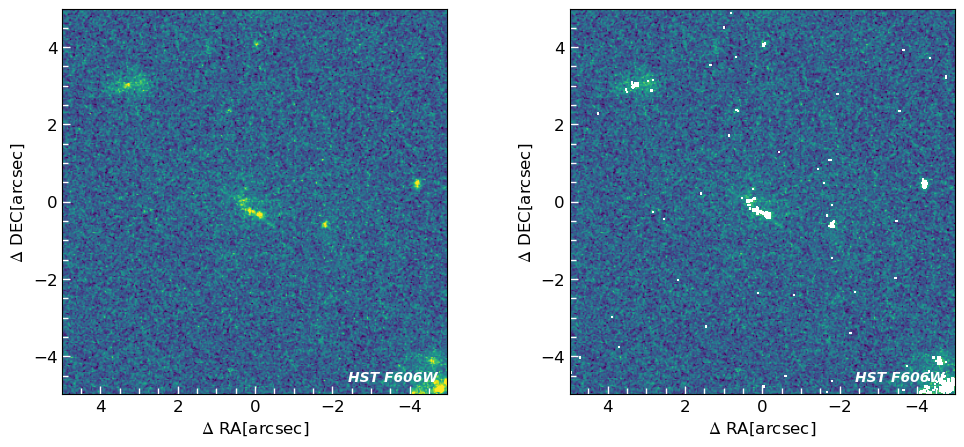

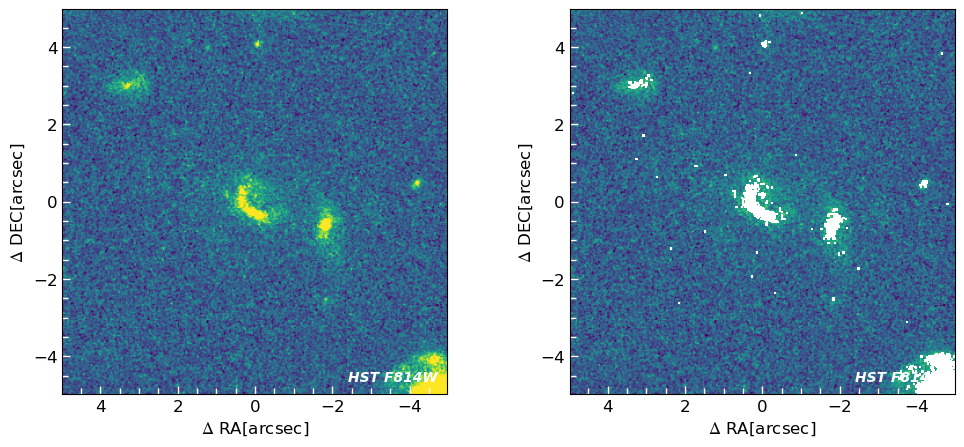

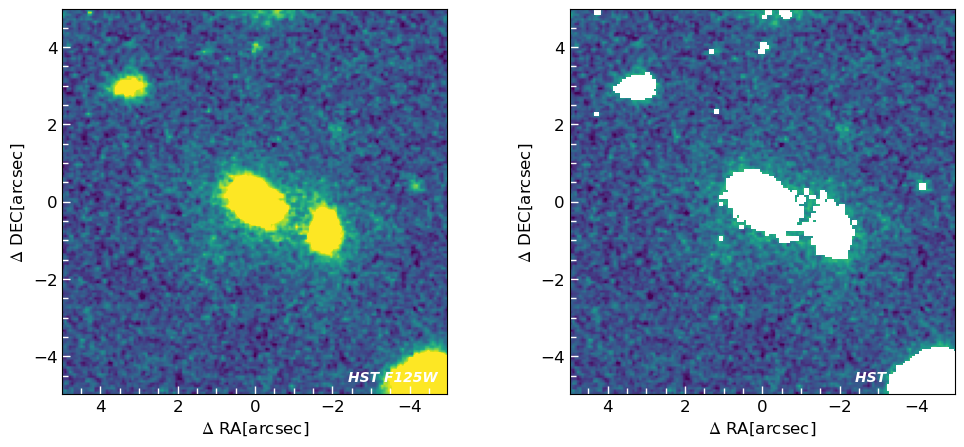

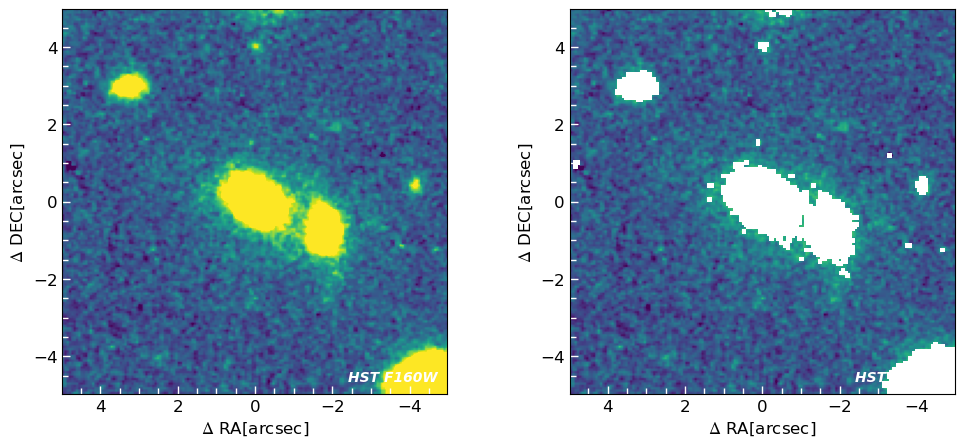

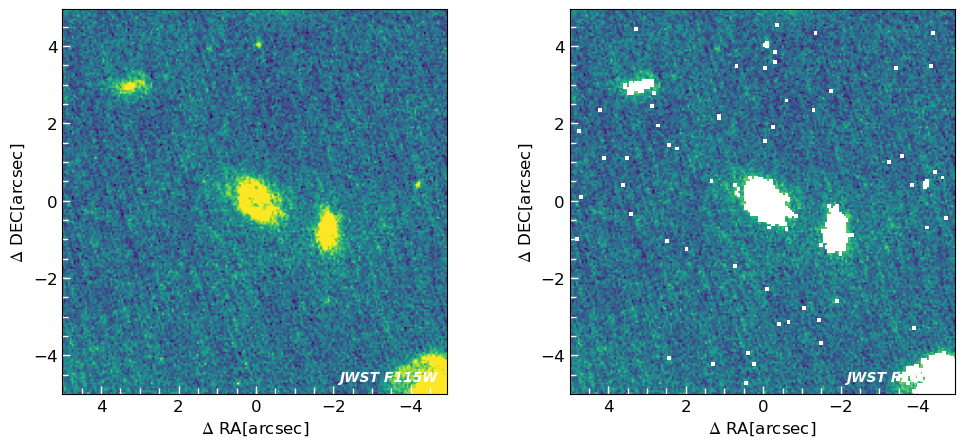

...

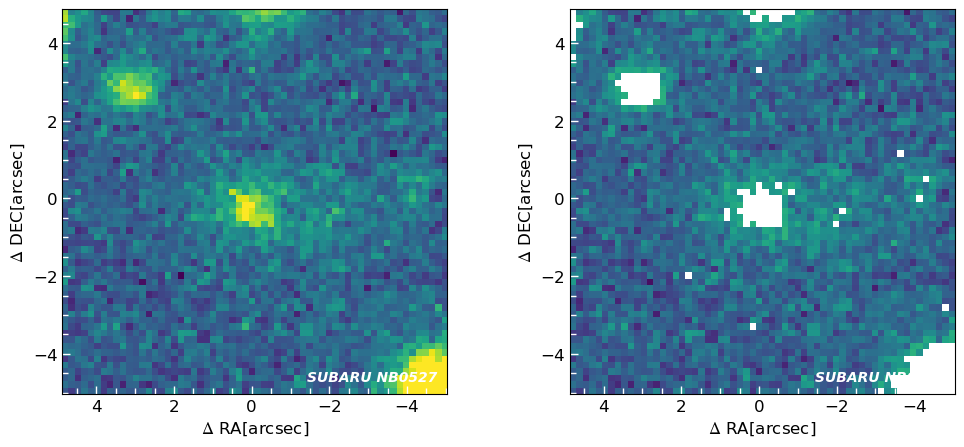

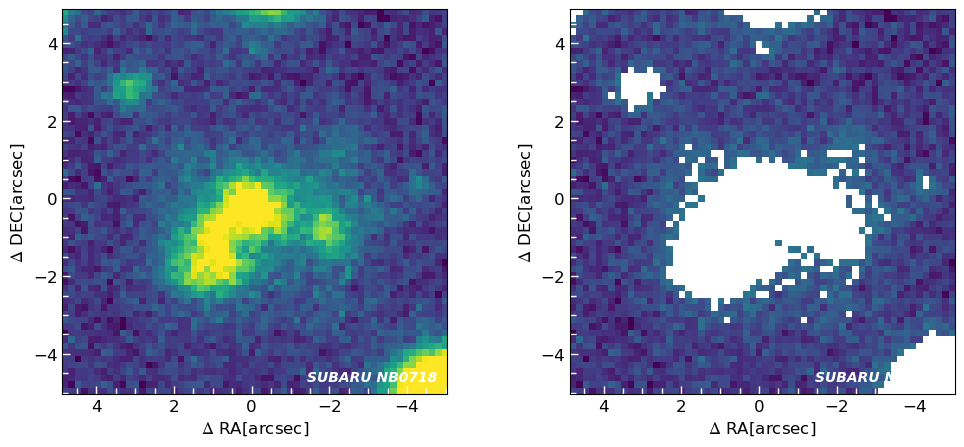

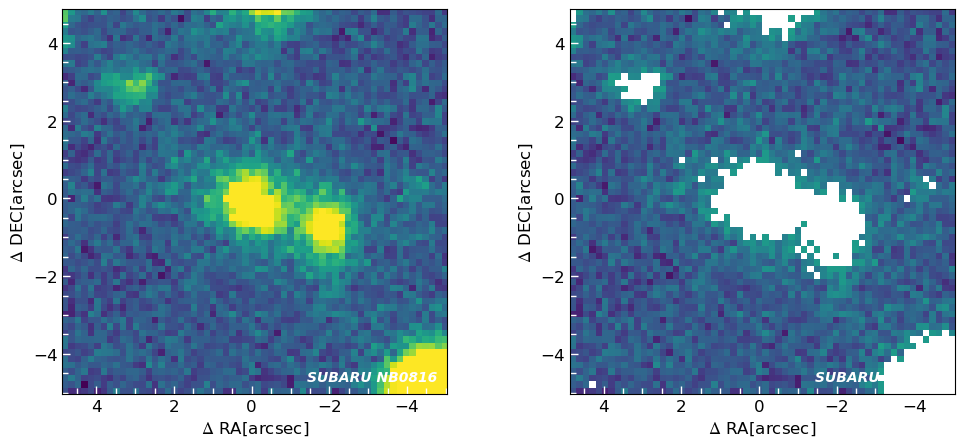

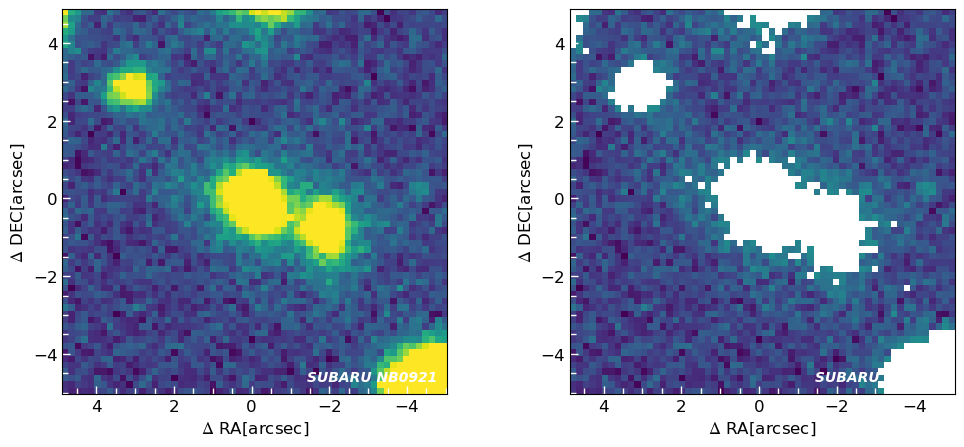

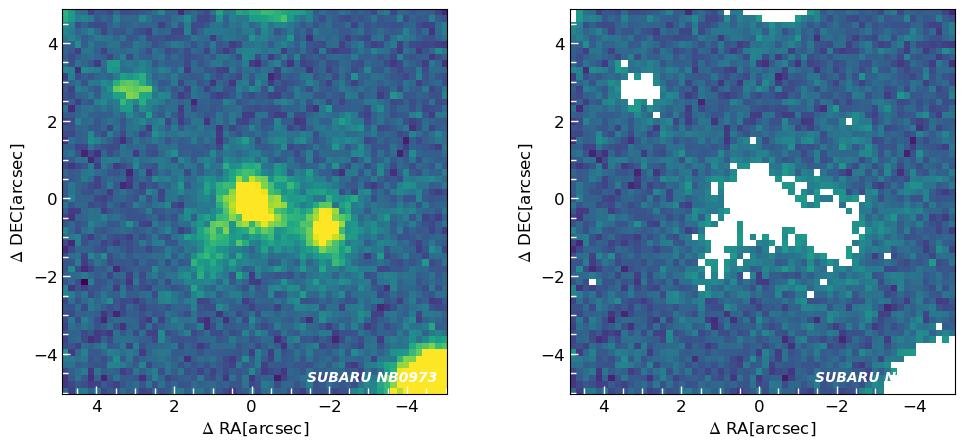

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


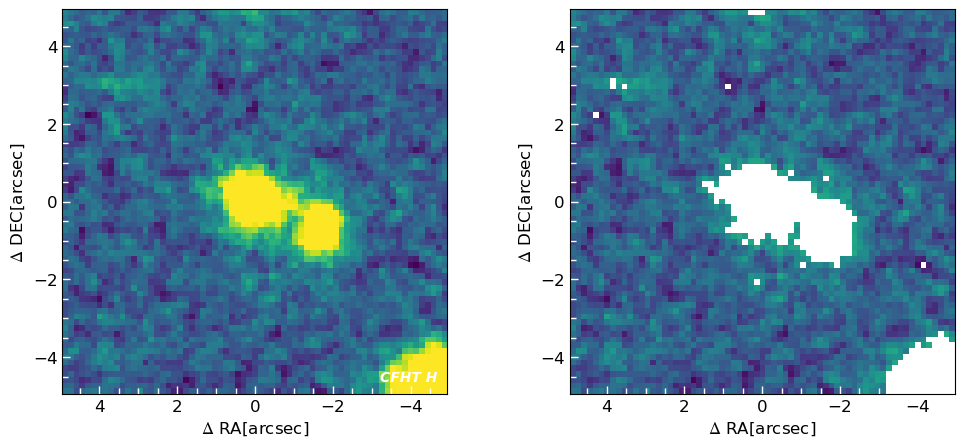

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


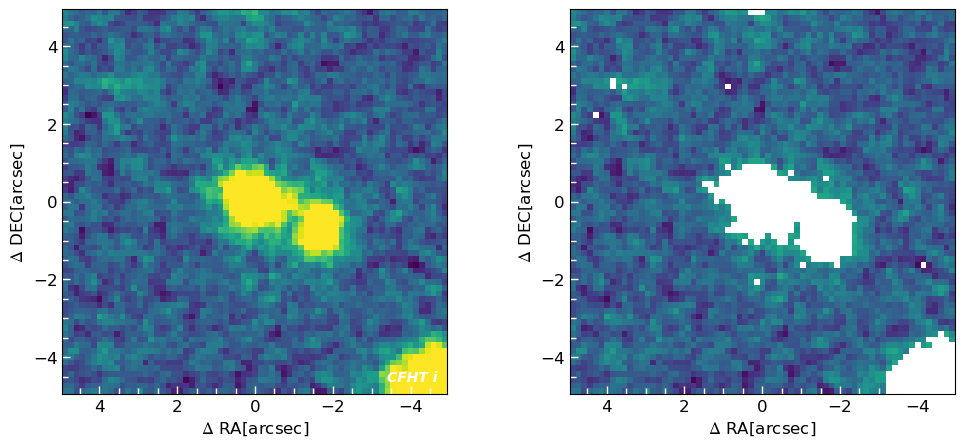

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


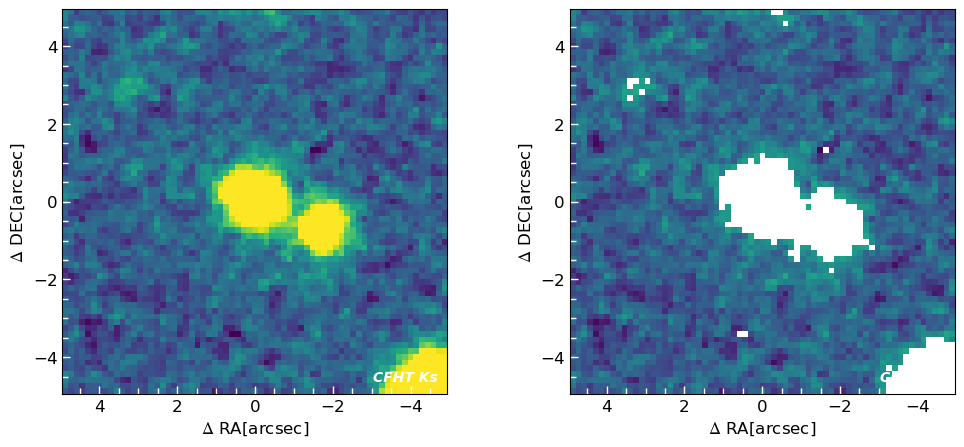

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


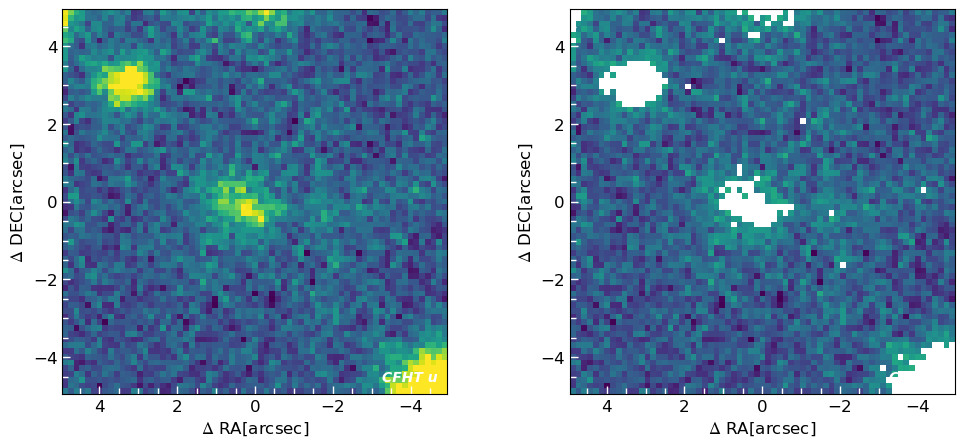

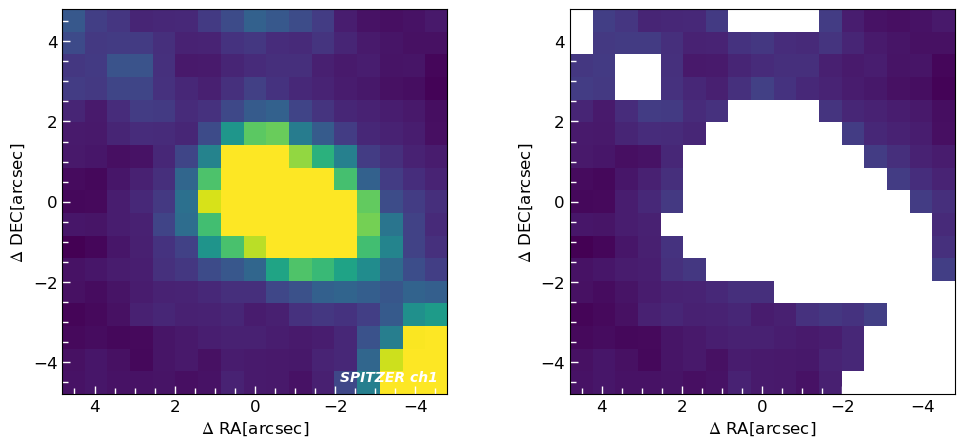

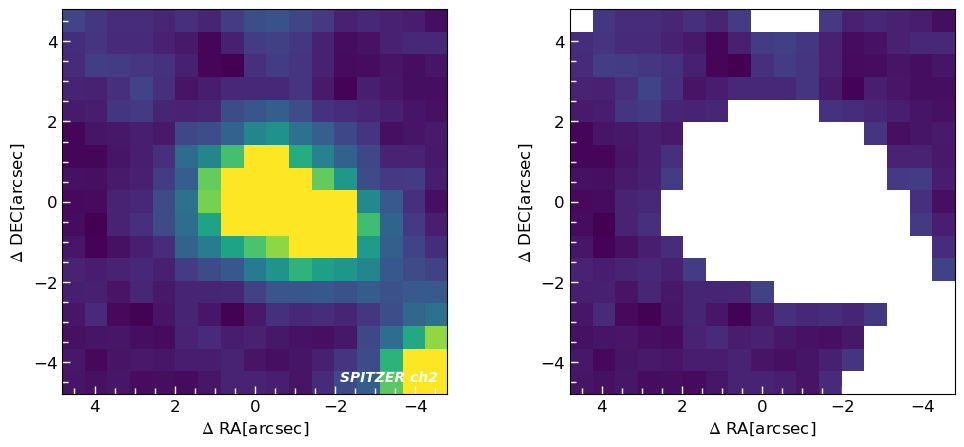

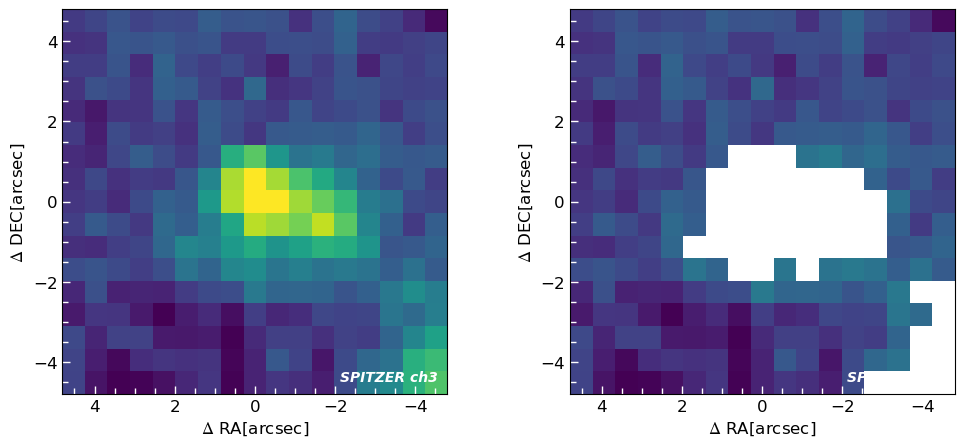

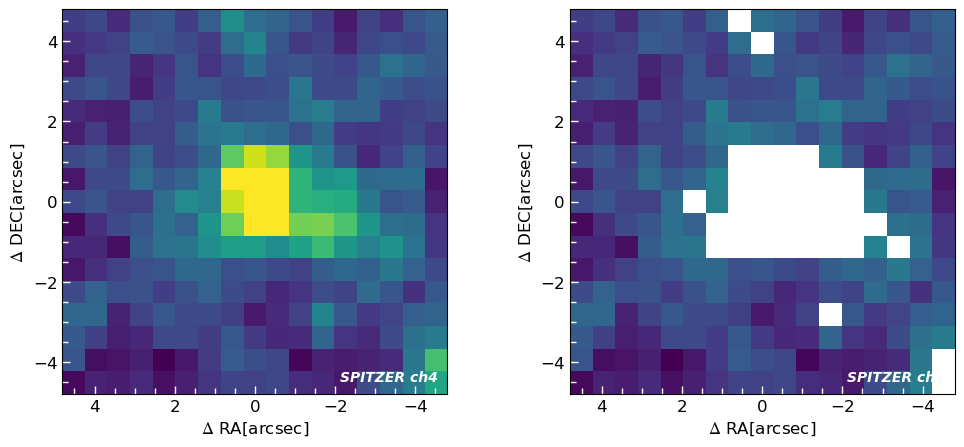

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


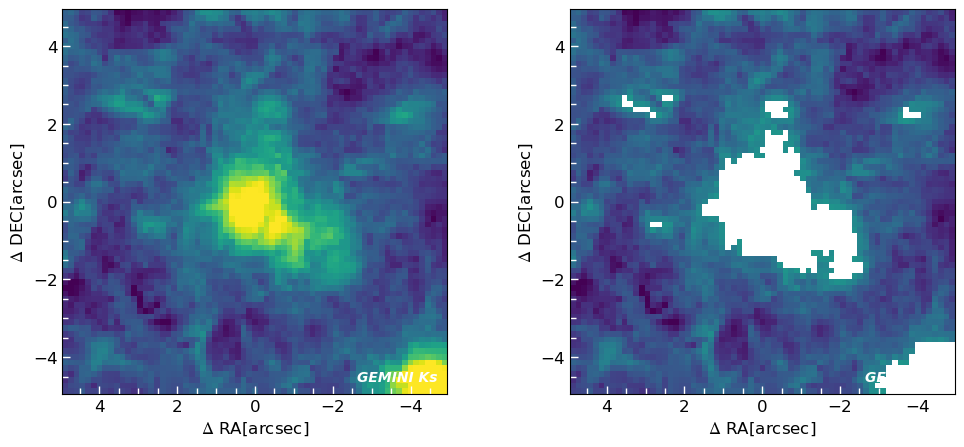

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]


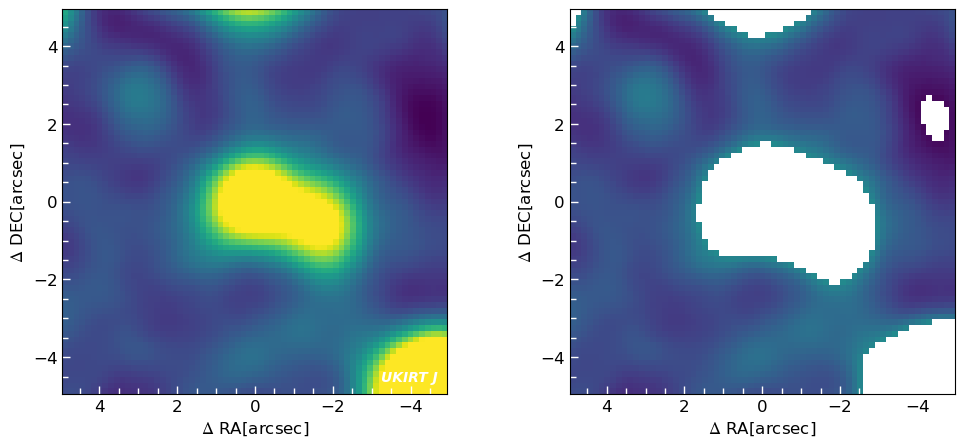

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-06-04T00:47:19.488' from MJD-END'. [astropy.wcs.wcs]


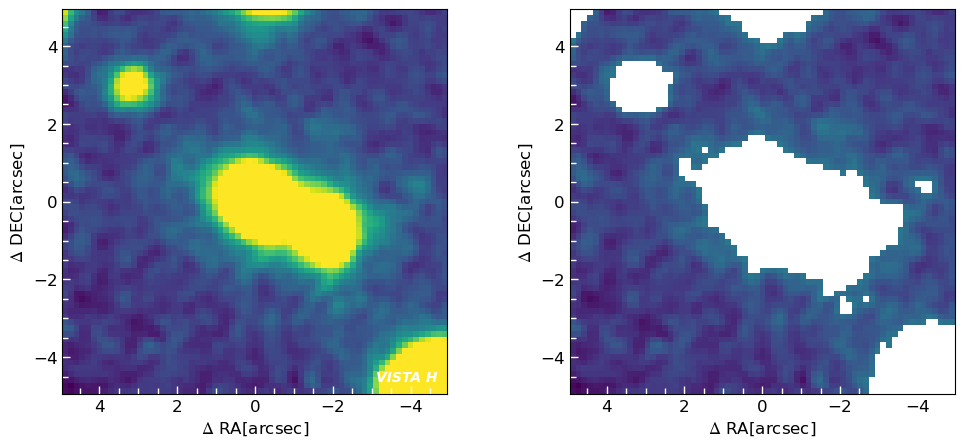

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-05-03T03:37:16.477' from MJD-END'. [astropy.wcs.wcs]


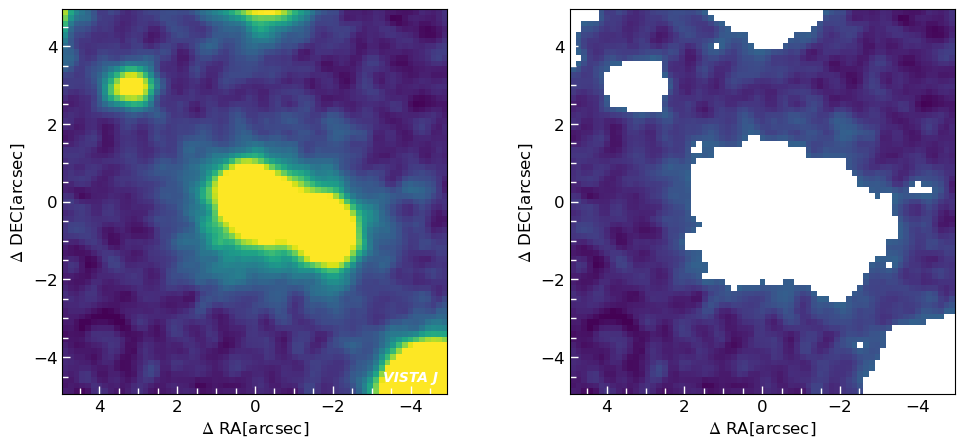

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-06-29T23:52:46.677' from MJD-END'. [astropy.wcs.wcs]


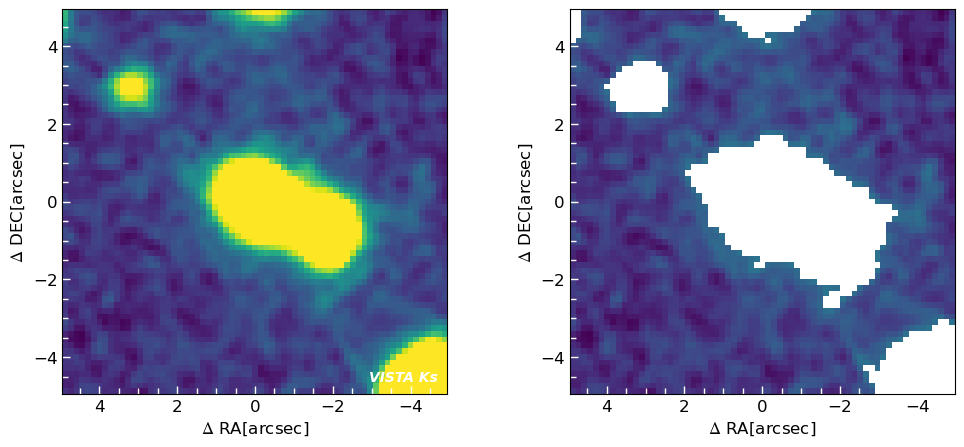

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-06-04T00:47:19.488' from MJD-END'. [astropy.wcs.wcs]


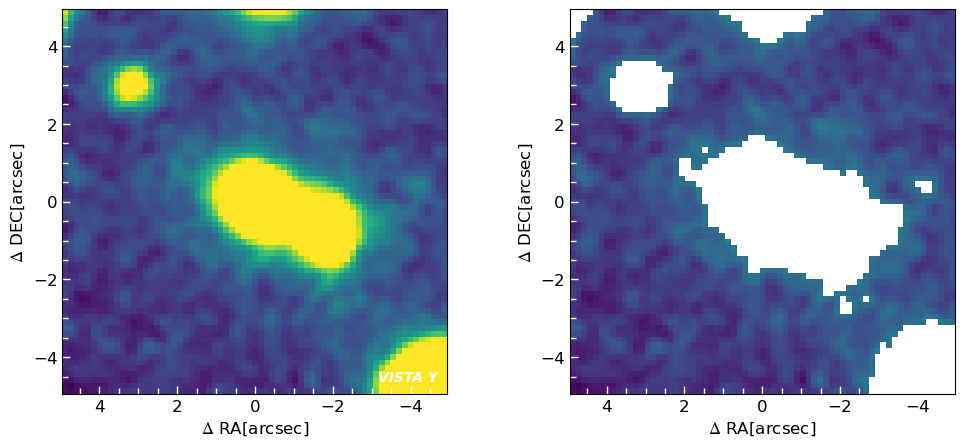

the RADECSYS keyword is deprecated, use RADESYSa. [astropy.wcs.wcs]
Set DATE-END to '2016-04-30T03:11:04.794' from MJD-END'. [astropy.wcs.wcs]


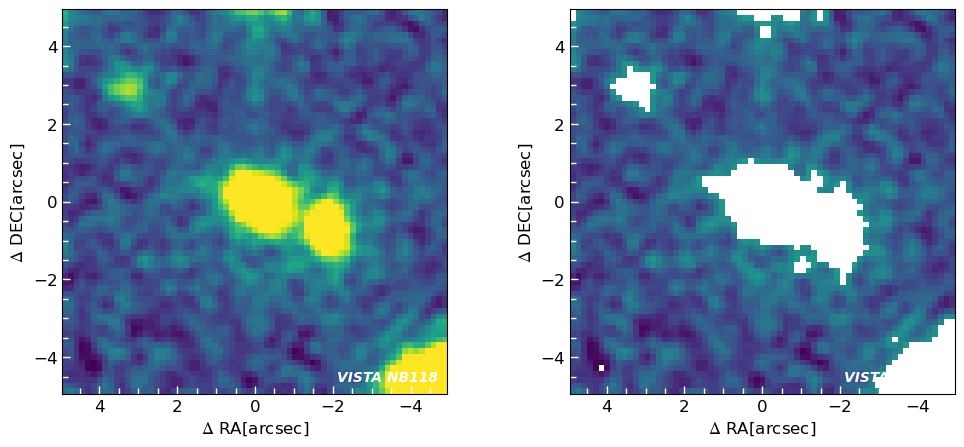

In [54]:
positions = SkyCoord('10:00:38.283 +2:11:29.33', frame='icrs', unit=(u.hourangle, u.deg))
raw_error_dic = {}
for telescope in valid_band.keys():
    raw_error_dic[telescope]  = {}
    for band in valid_band[telescope]:
        raw_error = bkg_sigma_clip(telescope, band, positions, sigma=3.0, maxit=5, image_size=10*u.arcsec)
        raw_error_dic[telescope][band] = raw_error

In [105]:
raw_sum_dic

{'HST': {'F606W': 7.669400427036818,
  'F814W': 15.40447784169373,
  'F125W': 62.912088084400175,
  'F160W': 72.81526820863753},
 'JWST': {'F115W': 567.4549094996382,
  'F150W': 1032.8834669679804,
  'F277W': 3728.877223187762,
  'F444W': 4437.204756094334},
 'SUBARU': {'HSC-G': 5.678248341058874,
  'HSC-I': 32.741526199436485,
  'HSC-R': 12.49661495412154,
  'HSC-Y': 63.171570842963085,
  'HSC-Z': 51.722515371086914,
  'IB0945': 62.57531556393104,
  'NB0387': 2.2978127742281447,
  'NB0527': 7.402593859636636,
  'NB0718': 37.366706717133326,
  'NB0816': 38.05526645451627,
  'NB0921': 52.66846743645844,
  'NB0973': 62.75788625811592},
 'CFHT': {'H': 11661.972661821219,
  'i': 11661.972661821219,
  'Ks': 24370.30885874034,
  'u': 49.35331328844854},
 'SPITZER': {'ch1': 4.242497896427322,
  'ch2': 5.690827603672628,
  'ch3': 32.41317266424111,
  'ch4': 93.70971857054084},
 'GEMINI': {'Ks': 17239.768290907043},
 'UKIRT': {'J': 10622.601168377629},
 'VISTA': {'H': 3019.1377735457645,
  'J':

In [52]:
raw_error_dic['SPITZER']

{}

In [55]:
pd.DataFrame(raw_sum_dic).to_csv('E:/THU/OII_emitter/photometry/raw_flux_sum.csv')

In [56]:
pd.DataFrame(raw_error_dic).to_csv('E:/THU/OII_emitter/photometry/raw_error_std.csv')

In [41]:
pd.DataFrame(pixel_area_dic).to_csv('E:/THU/OII_emitter/photometry/pixel_area_sum.csv')

In [57]:
(pd.DataFrame(raw_error_dic)*np.sqrt(pd.DataFrame(pixel_area_dic))).to_csv('E:/THU/OII_emitter/photometry/raw_error_sum.csv')

In [58]:
valid_band = {'HST':['F606W', 'F814W', 'F125W', 'F160W'],'JWST':['F115W', 'F150W', 'F277W', 'F444W'], 'SUBARU':['HSC-G','HSC-I','HSC-R','HSC-Y','HSC-Z','IB0945','NB0387','NB0527','NB0718','NB0816','NB0921','NB0973'],
             'CFHT':['H','i','Ks','u'], 'SPITZER':['ch1','ch2','ch3','ch4'], 'GEMINI':['Ks'], 'UKIRT':['J'], 'VISTA':['H','J','Ks','Y','NB118']}
unit_conv = {'HST': [3.33564*10**10], # * {header[PHOTPLAM]/A} * {header[PHOTFLAM]/ergcm^(-2)A^(-1)eletrons^(-1)} * {value}/ electrons*s^(-1)
            'JWST': [10**(-2)], # 10*nanoJansky to microJansky
            'SUBARU': [10**(6-(27-8.9)/2.5)], # zeropoint = 27 to microJansky (where?)
            'CFHT': [10**(-3)], # nanoJansky to microJansky
            'SPITZER': [10**12], # MJy to mJy
            'GEMINI': [10**(-3)], # nanoJansky to microJansky
            'UKIRT': [10**(6-(30-8.9)/2.5)], # zeropoint = 30
            'VISTA': [10**(6-(30-8.9)/2.5)], # zeropoint = 30
            }

In [59]:
unit_conv_df = pd.DataFrame(unit_conv)

In [60]:
raw_flux_sum = pd.read_csv('E:/THU/OII_emitter/photometry/raw_flux_sum.csv', index_col=0)

In [61]:
raw_error_sum = pd.read_csv('E:/THU/OII_emitter/photometry/raw_error_sum.csv', index_col=0)

In [48]:
raw_flux_sum*unit_conv_df.iloc[0]

,HST,JWST,SUBARU,CFHT,SPITZER,GEMINI,UKIRT,VISTA
F606W,0.705193,NaN,NaN,NaN,NaN,NaN,NaN,NaN
F814W,2.345951,NaN,NaN,NaN,NaN,NaN,NaN,NaN
F125W,7.241019,NaN,NaN,NaN,NaN,NaN,NaN,NaN
F160W,10.961592,NaN,NaN,NaN,NaN,NaN,NaN,NaN
F115W,NaN,5.674549,NaN,NaN,NaN,NaN,NaN,NaN
F150W,NaN,10.328835,NaN,NaN,NaN,NaN,NaN,NaN
F277W,NaN,37.288772,NaN,NaN,NaN,NaN,NaN,NaN
F444W,NaN,44.372048,NaN,NaN,NaN,NaN,NaN,NaN
HSC-G,NaN,NaN,0.326749,NaN,NaN,NaN,NaN,NaN
HSC-I,NaN,NaN,1.884078,NaN,NaN,NaN,NaN,NaN


In [65]:
(raw_flux_sum*unit_conv_df.iloc[0]).to_csv('E:/THU/OII_emitter/photometry/flux_sum_v1.csv')

In [66]:
(raw_error_sum*unit_conv_df.iloc[0]).to_csv('E:/THU/OII_emitter/photometry/error_sum_v1.csv')

In [67]:
raw_error_sum.stack().values.shape

(35,)

In [64]:
raw_error_sum

,HST,JWST,SUBARU,CFHT,SPITZER,GEMINI,UKIRT,VISTA
F606W,5.090852e-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN
F814W,6.641948e-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN
F125W,8.450211e-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN
F160W,7.815937e-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN
F115W,NaN,7.069776,NaN,NaN,NaN,NaN,NaN,NaN
F150W,NaN,5.509876,NaN,NaN,NaN,NaN,NaN,NaN
F277W,NaN,2.486408,NaN,NaN,NaN,NaN,NaN,NaN
F444W,NaN,2.750132,NaN,NaN,NaN,NaN,NaN,NaN
HSC-G,NaN,NaN,0.092346,NaN,NaN,NaN,NaN,NaN
HSC-I,NaN,NaN,0.162371,NaN,NaN,NaN,NaN,NaN
